In [ ]:
pip install -q keras-cv

In [ ]:
import requests
import json
import zipfile
from io import BytesIO
from pycocotools.coco import COCO
from PIL import Image, ImageDraw, ImageFont, ImageFilter, ImageChops
import cv2
from collections import defaultdict
import time
import logging
from tqdm import tqdm

import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as patches

import tensorflow as tf
import tensorflow_hub as hub
import keras_cv
from keras.applications import MobileNetV2
from keras import layers, models, callbacks, losses
from keras.activations import sigmoid
from keras.optimizers import Adam, AdamW
from keras.initializers import VarianceScaling

Using TensorFlow backend


In [ ]:
# Fix randomness and hide warnings
seed = 42
tf.autograph.set_verbosity(0)
tf.get_logger().setLevel(logging.ERROR)
tf.compat.v1.logging.set_verbosity(tf.compat.v1.logging.ERROR)
tf.random.set_seed(seed)
tf.compat.v1.set_random_seed(seed)

import os
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'
os.environ['PYTHONHASHSEED'] = str(seed)
os.environ['MPLCONFIGDIR'] = os.getcwd()+'/configs/'

import warnings
warnings.simplefilter(action='ignore', category=FutureWarning)
warnings.simplefilter(action='ignore', category=Warning)

np.random.seed(seed)

import random
random.seed(seed)

In [ ]:
from google.colab import drive
drive.mount('/content/drive')
os.makedirs('/content/drive/MyDrive/DL4CV_skip_connections', exist_ok=True)
%cd '/content/drive/MyDrive/DL4CV_skip_connections'

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
/content/drive/MyDrive/DL4CV_skip_connections


# Introduction

We are the group "Skip Connections", welcome to our notebook!

For this project, we are going to build SafeBlur, a model that blurs sensitive objects in images from office settings.

Our goal is to test what we learned in the DL4CV course, and what better way to do it through a challenging task: building a Mask R-CNN! A Mask R-CNN is useful for our scope in multiple ways. Firstly, it provides a way to segment objects related to a specific class (laptops or monitors for example). Secondly, it allows the final user to select those specific objects, in case they decide to unblur them. After segmenting the objects, their masks can be used to detect the regions to be blurred.

This is going to be really challenging; we will try to provide an implementation of the paper that is as simple (and close) as it can get, within our computational and time constraints. At the end, it is our intention to compare our results to a model fine-tuned through the Detectron2 frameworks, which is well-known among computer vision practitioners.

# Downloading data from COCO (do not execute)


At first we want to explore the two most sensitive classes of objects that can appear in photos from the office: monitors and laptops. We can retrieve these two datasets from COCO.

NB: you only need to run the current section once, so if you restart again the notebook you can skip this.

In [ ]:
# Create instances folder
os.makedirs('instances', exist_ok=True)

# Initialize the COCO api with training data from the 2017 dataset
!wget -O instances/instances_train2017.zip "http://images.cocodataset.org/annotations/annotations_trainval2017.zip"

# Extract the contents of the zip file
with zipfile.ZipFile('instances/instances_train2017.zip', 'r') as zip_ref:
    for file_info in zip_ref.infolist():
        file_info.filename = os.path.basename(file_info.filename)  # Get only the filename
        zip_ref.extract(file_info, 'instances')

--2023-12-14 15:15:11--  http://images.cocodataset.org/annotations/annotations_trainval2017.zip
Resolving images.cocodataset.org (images.cocodataset.org)... 52.216.52.97, 52.217.196.201, 52.217.82.100, ...
Connecting to images.cocodataset.org (images.cocodataset.org)|52.216.52.97|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 252907541 (241M) [application/zip]
Saving to: ‘instances/instances_train2017.zip’

instances/instances 100%[===================>] 241.19M  44.8MB/s    in 6.0s    

2023-12-14 15:15:18 (40.4 MB/s) - ‘instances/instances_train2017.zip’ saved [252907541/252907541]



In [ ]:
# Instantiate COCO specifying the annotations json path
coco = COCO('instances/instances_train2017.json')

# Specify a list of category names of interest
catIds_tv = coco.getCatIds(catNms=['tv'])
catIds_laptop = coco.getCatIds(catNms=['laptop'])

# Get the corresponding image ids and images using loadImgs
imgIds_tv = coco.getImgIds(catIds=catIds_tv)
imgIds_laptop = coco.getImgIds(catIds=catIds_laptop)
print(f"Available monitor images in the dataset of reference: {len(imgIds_tv)}")
print(f"Available laptop images in the dataset of reference: {len(imgIds_laptop)}")

loading annotations into memory...
Done (t=24.75s)
creating index...
index created!
Available monitor images in the dataset of reference: 4561
Available laptop images in the dataset of reference: 3524


In [ ]:
# Select 2000 images for each class
imgIds = list(set(imgIds_tv[:2000]).union(set(imgIds_laptop[:2000])))
images = coco.loadImgs(imgIds)
images[0]

{'license': 1,
 'file_name': '000000483328.jpg',
 'coco_url': 'http://images.cocodataset.org/train2017/000000483328.jpg',
 'height': 375,
 'width': 500,
 'date_captured': '2013-11-15 22:38:44',
 'flickr_url': 'http://farm2.staticflickr.com/1027/533762534_75e6af7d59_z.jpg',
 'id': 483328}

In [ ]:
# Create a training, validation and test set of file ids
np.random.shuffle(images)

dataset_size = len(images)
training_ids = [image['file_name'].replace('.jpg', '') for image in images[:int(0.8*dataset_size)]]
validation_ids = [image['file_name'].replace('.jpg', '') for image in images[int(0.8*dataset_size):int(0.9*dataset_size)]]
test_ids = [image['file_name'].replace('.jpg', '') for image in images[int(0.9*dataset_size):]]

# Create the folder path
folder_path = 'coco_tv_laptop/ids'
os.makedirs(folder_path, exist_ok=True)

# Save the lists
with open(os.path.join(folder_path, 'training_ids.txt'), 'w') as file:
    file.write('\n'.join(training_ids))

with open(os.path.join(folder_path, 'validation_ids.txt'), 'w') as file:
    file.write('\n'.join(validation_ids))

with open(os.path.join(folder_path, 'test_ids.txt'), 'w') as file:
    file.write('\n'.join(test_ids))

In [ ]:
training_ids[:5]

['000000074078',
 '000000486361',
 '000000446088',
 '000000158428',
 '000000173464']

In [ ]:
# Create a temporary dataset of image info dictionaries
training_info = [image for image in images[:int(0.8*dataset_size)]]
validation_info = [image for image in images[int(0.8*dataset_size):int(0.9*dataset_size)]]
test_info = [image for image in images[int(0.9*dataset_size):]]

In [ ]:
# Create directories if they don't exist
os.makedirs('coco_tv_laptop/arrays/', exist_ok=True)

# Set a fixed size for the images.
# We can warp the training images to a fixed size of 224x224,
# even though in the original paper the authors mention a size of 1000x600.
IMG_SIZE = (224, 224)

# Function to download and save an image, masks and annotations
def download_image_and_save_ann(image_info):
    response = requests.get(image_info['coco_url'])
    if response.status_code == 200:
        image = Image.open(BytesIO(response.content))
        # Resize the image
        resized_image = image.resize(IMG_SIZE)
        # Convert the image to a NumPy array
        image_array = np.array(resized_image)

        # Download monitor and laptop annotations for this image
        image_annotations = coco.loadAnns(coco.getAnnIds(imgIds=image_info['id'], catIds = [72, 73], iscrowd=None))
        # Add width and height of image to annotations
        for ann in image_annotations:
            width = image_info['width']
            height = image_info['height']
            # Normalize bboxes
            ann['bbox'][0] = ann['bbox'][0]*224/width
            ann['bbox'][2] = ann['bbox'][2]*224/width
            ann['bbox'][1] = ann['bbox'][1]*224/height
            ann['bbox'][3] = ann['bbox'][3]*224/height

        # Retrieve the masks from the annotations
        mask_out = np.zeros(image.size[::-1])
        for ann in image_annotations:
            mask = coco.annToMask(ann)
            mask *= ann['category_id']
            # Insert only where the zeros are
            mask_out = np.where(mask_out == 0, mask, mask_out)
        # Resize the mask
        mask_out = Image.fromarray(mask_out).resize(IMG_SIZE, Image.Resampling.NEAREST)
        mask_out = np.array(mask_out)

        # Return the image array with the batch dimension
        return image_array.reshape(1, 224, 224, 3), mask_out.reshape(1, 224, 224, 1), image_annotations

In [ ]:
# Create dictionaries to store {id: annotations}
# The images can be saved as a numpy array
train_anns = {}
validation_anns = {}
test_anns = {}

# Create a new folder
arrays_folder_path = 'coco_tv_laptop/arrays'
os.makedirs(arrays_folder_path, exist_ok=True)

In [ ]:
# Iterate over images, concatenate images and masks, save into folders
# Train
train_img_arrays = []
train_mask_arrays = []

for image_info in tqdm(training_info):
    img_array, mask_array, annotations = download_image_and_save_ann(image_info)
    train_img_arrays.append(img_array)
    train_mask_arrays.append(mask_array)
    train_anns[image_info['id']] = annotations

train_img_np = np.concatenate(train_img_arrays, axis = 0)
train_mask_np = np.concatenate(train_mask_arrays, axis = 0)
del train_img_arrays, train_mask_arrays
# Save arrays
np.savez(os.path.join(arrays_folder_path, 'train_images.npz'), train_img_np)
np.savez(os.path.join(arrays_folder_path, 'train_masks.npz'), train_mask_np)
# Save dictionary
with open('coco_tv_laptop/arrays/train_annotations.json', 'w') as json_file:
    json.dump(train_anns, json_file)

100%|██████████| 2838/2838 [09:43<00:00,  4.87it/s]


In [ ]:
# Validation
val_img_arrays = []
val_mask_arrays = []
for image_info in tqdm(validation_info):
    img_array, mask_array, annotations = download_image_and_save_ann(image_info)
    val_img_arrays.append(img_array)
    val_mask_arrays.append(mask_array)
    validation_anns[image_info['id']] = annotations

val_img_np = np.concatenate(val_img_arrays, axis = 0)
val_mask_np = np.concatenate(val_mask_arrays, axis = 0)
del val_img_arrays, val_mask_arrays
# Save arrays
np.savez(os.path.join(arrays_folder_path, 'val_images.npz'), val_img_np)
np.savez(os.path.join(arrays_folder_path, 'val_masks.npz'), val_mask_np)
# Save dictionary
with open('coco_tv_laptop/arrays/val_annotations.json', 'w') as json_file:
    json.dump(validation_anns, json_file)

100%|██████████| 355/355 [01:15<00:00,  4.71it/s]


In [ ]:
# Test
test_img_arrays = []
test_mask_arrays = []
for image_info in tqdm(test_info):
    img_array, mask_array, annotations = download_image_and_save_ann(image_info)
    test_img_arrays.append(img_array)
    test_mask_arrays.append(mask_array)
    test_anns[image_info['id']] = annotations

test_img_np = np.concatenate(test_img_arrays, axis = 0)
test_mask_np = np.concatenate(test_mask_arrays, axis = 0)
del test_img_arrays, test_mask_arrays
# Save arrays
np.savez(os.path.join(arrays_folder_path, 'test_images.npz'), test_img_np)
np.savez(os.path.join(arrays_folder_path, 'test_masks.npz'), test_mask_np)
# Save dictionary
with open('coco_tv_laptop/arrays/test_annotations.json', 'w') as json_file:
    json.dump(test_anns, json_file)

100%|██████████| 355/355 [01:12<00:00,  4.90it/s]


In [ ]:
print(train_img_np.shape, val_img_np.shape, test_img_np.shape)
print(train_mask_np.shape, val_mask_np.shape, test_mask_np.shape)
print(len(train_anns), len(validation_anns), len(test_anns))

(2838, 224, 224, 3) (355, 224, 224, 3) (355, 224, 224, 3)
(2838, 224, 224, 1) (355, 224, 224, 1) (355, 224, 224, 1)
2838 355 355


# Data loading and exploration

In [ ]:
# Download the train/val/test splits
folder_path = 'coco_tv_laptop/ids'

def read_ids_from_file(file_path):
    with open(file_path, 'r') as file:
        ids = file.read().splitlines()
    return ids

# Load training, validation, and test ids
training_ids = read_ids_from_file(os.path.join(folder_path, 'training_ids.txt'))
validation_ids = read_ids_from_file(os.path.join(folder_path, 'validation_ids.txt'))
test_ids = read_ids_from_file(os.path.join(folder_path, 'test_ids.txt'))

print(training_ids[:5])

['000000074078', '000000486361', '000000446088', '000000158428', '000000173464']


In [ ]:
# Download the image arrays
arrays_folder_path = 'coco_tv_laptop/arrays'
train_np = np.load(os.path.join(arrays_folder_path, 'train_images.npz'))['arr_0']
val_np = np.load(os.path.join(arrays_folder_path, 'val_images.npz'))['arr_0']
test_np = np.load(os.path.join(arrays_folder_path, 'test_images.npz'))['arr_0']
print(train_np.shape, val_np.shape, test_np.shape)

(2838, 224, 224, 3) (355, 224, 224, 3) (355, 224, 224, 3)


In [ ]:
# Download the mask arrays
train_mask_np = np.load(os.path.join(arrays_folder_path, 'train_masks.npz'))['arr_0']
val_mask_np = np.load(os.path.join(arrays_folder_path, 'val_masks.npz'))['arr_0']
test_mask_np = np.load(os.path.join(arrays_folder_path, 'test_masks.npz'))['arr_0']
print(train_mask_np.shape, val_mask_np.shape, test_mask_np.shape)

(2838, 224, 224, 1) (355, 224, 224, 1) (355, 224, 224, 1)


In [ ]:
# Download the json files with the annotations
with open(os.path.join(arrays_folder_path, 'train_annotations.json')) as json_file:
    train_anns = json.load(json_file)
with open(os.path.join(arrays_folder_path, 'val_annotations.json')) as json_file:
    validation_anns = json.load(json_file)
with open(os.path.join(arrays_folder_path, 'test_annotations.json')) as json_file:
    test_anns = json.load(json_file)
print(len(train_anns), len(validation_anns), len(test_anns))

2838 355 355


We now need to create a dataset of bounding boxes.

In [ ]:
def create_bb_dataset(annotations):
    bboxes = []
    for ann in annotations:
        bboxes.append(np.array(ann['bbox']).reshape(1, 4))
    return np.concatenate(bboxes, axis = 0)

train_bounding_boxes = []
for id in training_ids:
    bboxes = create_bb_dataset(train_anns[id.lstrip("0")])
    train_bounding_boxes.append(bboxes)

val_bounding_boxes = []
for id in validation_ids:
    bboxes = create_bb_dataset(validation_anns[id.lstrip("0")])
    val_bounding_boxes.append(bboxes)

test_bounding_boxes = []
for id in test_ids:
    bboxes = create_bb_dataset(test_anns[id.lstrip("0")])
    test_bounding_boxes.append(bboxes)

Our preparation is complete! Let's try to visualize one of the images.

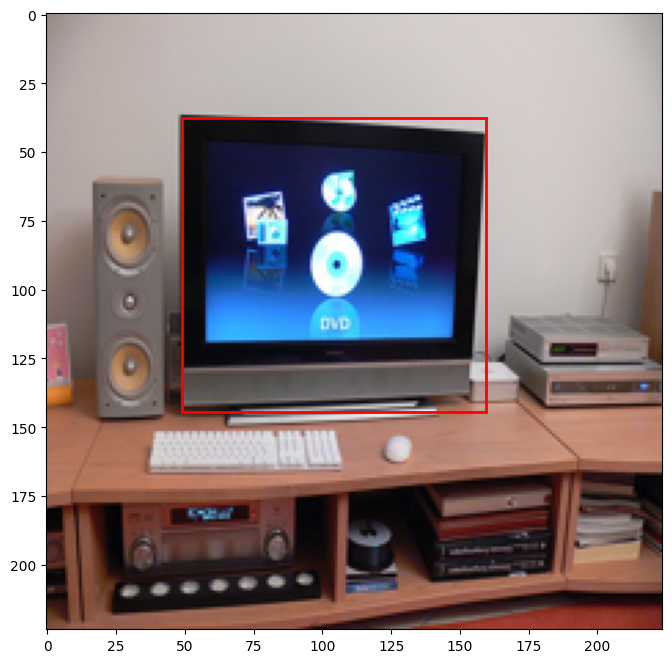

In [ ]:
# Take an image from the test set
index = 22
img_0 = test_np[index]

# Get its bounding boxes
img_0_bboxes_np = test_bounding_boxes[index]
img_0_bboxes = [img_0_bboxes_np[i] for i in range(img_0_bboxes_np.shape[0])]

# Visualize the image
fig, ax = plt.subplots(1, figsize=(8, 8))  # Use figsize to set the size of the plot
ax.imshow(img_0)

# Plot bounding boxes
for bbox in img_0_bboxes:
    x_min, y_min, width, length = bbox
    rect = patches.Rectangle((x_min, y_min), width, length, linewidth=2, edgecolor='r', facecolor='none')
    ax.add_patch(rect)

plt.show()

# Out-of-the-box Mask R-CNN

Here we are using a pre-trained model from TF Hub, so that we can understand what our final product will look like.

## Define Model Architecture
The model is a pre-trained Mask R-CNN, which is based on a Inception ResNet backbone layer. We know this architecture very well, since we implemented it from the paper in our previous assignment!

In [ ]:
# Our model's name and URL to download it
model_name = "Mask R-CNN Inception ResNet V2 1024x1024"
model_handle = "https://tfhub.dev/tensorflow/mask_rcnn/inception_resnet_v2_1024x1024/1"

In [ ]:
# Now we load the model (will take some time)
print("Loading model...")
start = time.time()
hub_model = hub.load(model_handle)
print(f"Model loaded! Loading time: {time.time()-start:.2f}s")

Loading model...
Model loaded! Loading time: 63.02s


## Inference and blurring functions

We created these functions after a lot of fine-tuning, so we just report the results here to avoid our notebook from being too cumbersome to read. We have adapted them from the notebook given in class, which is a further adaptation from a TF notebook on object detection.

In [ ]:
def blur(show_image, show_boxes, show_masks, max_boxes_to_draw=50):
  """
  This function blurs the sensitive objects in the input image.
  """
  # Initialize blurred image and its mask
  pil_image = Image.fromarray(show_image).convert('RGBA')
  blurred_image = pil_image.filter(ImageFilter.GaussianBlur(radius=100))
  blur_mask = np.zeros(show_image.shape[:2], dtype=np.uint8)

  # As the predicted boxes are normalized in [0, 1], we rescale them to the
  # image's shape
  image_height = show_image.shape[0]
  image_width = show_image.shape[1]
  resize_factor = [image_height, image_width, image_height, image_width]
  full_boxes = resize_factor * show_boxes

  # We select at most max_boxes_to_draw predictions
  final_boxes = full_boxes[:max_boxes_to_draw]

  for box, mask in zip(final_boxes, show_masks):
    y_0, x_0, y_1, x_1 = box
    y_0 = int(round(y_0))
    x_0 = int(round(x_0))
    y_1 = int(round(y_1))
    x_1 = int(round(x_1))
    box_width = x_1-x_0
    box_height = y_1-y_0

    # Resize the mask to match the region using PIL.Image.resize
    mask_image = Image.fromarray((mask * 255).astype(np.uint8), 'L')
    resized_mask = mask_image.resize((box_width, box_height))
    mask_array = np.array(resized_mask)
    mask_array = (mask_array > 0).astype(np.uint8)

    # Paste the mask into the blur_mask, first segmenting the bounding boxes
    blur_mask[y_0:y_1, x_0:x_1] += mask_array

  # Clip the mask array
  blur_mask = np.clip(blur_mask, 0, 1)

  # The output is a linear combination of the blurred image and the original image,
  # where the weight is represented by blur_mask
  blur_mask = np.expand_dims(blur_mask, 2)
  background_image = show_image*(1-blur_mask)
  blurred_image = np.array(blurred_image, dtype=np.uint8)[:, :, :3]*blur_mask
  composite_image = blurred_image + background_image

  return composite_image

In [ ]:
def infer(image, plot = False, min_confidence = 0.01):
  """Function to perform the whole inference process.

  Args:
    image: the input image
    min_confidence: confidence threshold for predictions
  """

  # We call the model and process its results
  start = time.time()
  results = hub_model(image)
  result = {key:value.numpy() for key,value in results.items()}
  print(f"Inference time: {time.time()-start:.2f}s") #print inference time

  # Here we select the results. As the network took as input a batch of images having shape
  # [1, n_rows, n_columns, 3], all the outputs have the batch dimension as well
  # (e.g. for boxes the shape is [1, n_boxes, 4]). We therefore remove the batch
  # dimension by selecting the first (and only) element for each result.
  classes = result['detection_classes'][0].astype(int)
  boxes = result['detection_boxes'][0]
  confidence_scores = result['detection_scores'][0]
  masks = result['mask_predictions']

  # Now we actually discard the low-confidence predictions
  over_threshold_mask = confidence_scores >= min_confidence
  classes_mask = (classes == 72) | (classes == 73) # select only classes monitor and laptop
  predictions_mask = over_threshold_mask & classes_mask

  final_boxes = boxes[predictions_mask]
  final_classes = classes[predictions_mask]
  final_scores = confidence_scores[predictions_mask]
  intermediate_masks = masks[predictions_mask, final_classes-1]
  # The masks are not binary, but logits
  intermediate_masks_prob = sigmoid(intermediate_masks).numpy()
  final_masks = intermediate_masks_prob > 0.5 # binarization

  # If the image is in the format required by the model (i.e. [1, h, w, 3]) we
  # remove the first dimension
  show_image = image[0] if image.shape[0] == 1 else image

  # Blur output of the model
  start = time.time()
  blurred_image = blur(show_image, final_boxes, final_masks)
  print(f"Blur time: {time.time()-start:.2f}s")

  if plot:
    plt.figure(figsize=(10, 5))

    # Plotting the original image
    plt.subplot(1, 2, 1)
    plt.imshow(show_image)
    plt.title('Original Image')

    # Plotting the blurred image
    plt.subplot(1, 2, 2)
    plt.imshow(blurred_image)
    plt.title('Blurred Image')

    plt.show()
  return blurred_image

## Final result

Inference time: 86.92s
Blur time: 0.01s


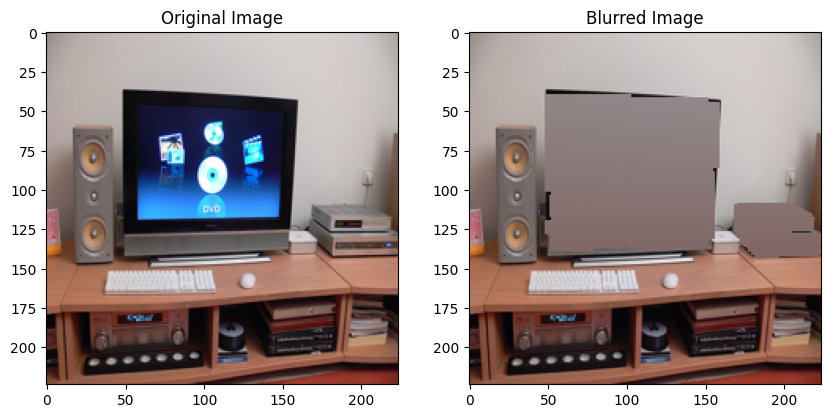

In [ ]:
_ = infer(img_0.reshape(1, 224, 224, 3), plot = True)

That is a nice visual result :)

It is what we are aiming for from this notebook!



# Mask R-CNN from scratch: Region Proposal Network

Since we cannot directly fine-tune the pretrained model from TF Hub, we decided to implement our own Mask R-CNN from scratch. Here we are starting from the RPN, and later we can add the classification head, the regression head, and the mask head.


## Backbone layer

Let's start by importing the backbone of our neural network: we can leverage a pretrained network with the weights from ImageNet.

In [ ]:
# Set the input size
input_size = (224, 224, 3)

# Load MobileNetV2 as the backbone (excluding the top layers)
backbone_layer = MobileNetV2(weights='imagenet', include_top=False, input_shape=input_size)
input = backbone_layer.input

# Remove some blocks to reduce down-sampling
# (otherwise the feature map will not be large enough to contain the anchors)
backbone_output = backbone_layer.get_layer('block_11_expand_relu').output

# Create a model
model = models.Model(inputs=input, outputs=backbone_output)

# Display the summary of the model
model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 Conv1 (Conv2D)              (None, 112, 112, 32)         864       ['input_1[0][0]']             
                                                                                                  
 bn_Conv1 (BatchNormalizati  (None, 112, 112, 32)         128       ['Conv1[0][0]']               
 on)                                                                                              
                                                                                                  
 Conv1_relu (ReLU)           (None, 112, 112, 32)         0         ['bn_Conv1[0][0]']        

## Anchors and ground-truth tensors

For the next step, we need to create a Region Proposal Network, that will become the first head connected to the backbone layer.

At first, we need to create a pyramid of anchors for each pixel in the last feature map. The difficult part will be to carefully implement the loss function, with a special regard to its inputs.

In [ ]:
# Build pyramids of anchors --hardcoded
# Assuming a feature map of 14x14
feature_map_height = 14
feature_map_width = 14

# Define anchor sizes and dimensions
anchor_sizes = [(2, 1), (1, 1), (1, 2)]
anchor_dimensions = [2, 4, 6]
k = len(anchor_sizes)*len(anchor_dimensions)

# Initialize the tensors to store anchors and masks
anchors_tensor_min_xywh = np.zeros((1, feature_map_height*feature_map_width, k, 4))
boundary_mask = np.ones((1, feature_map_height*feature_map_width, k, 1))

# Iterate over each position in the feature map
for y in range(feature_map_height):
    for x in range(feature_map_width):
        # Iterate over each anchor size
        for size_idx, size in enumerate(anchor_sizes):
            # Iterate over each anchor dimension
            for dim_idx, dim in enumerate(anchor_dimensions):

                # Calculate anchor coordinates
                height = size[0] * dim / feature_map_height
                width = size[1] * dim / feature_map_width
                x_min = (x + 0.5) / feature_map_width - width * 0.5
                y_min = (y + 0.5) / feature_map_height - height * 0.5

                # If the anchors cross the borders, exclude it from the mask
                if x_min < 0 or x_min + width > 1 or y_min < 0 or y_min + height > 1:
                    boundary_mask[0, y * feature_map_height + x, size_idx * len(anchor_dimensions) + dim_idx, :] = 0

                # Store anchor coordinates in the tensors
                anchors_tensor_min_xywh[0, y * feature_map_height + x, size_idx * len(anchor_dimensions) + dim_idx, :] = [x_min, y_min, width, height]

# Convert NumPy arrays to TensorFlow tensors
anchors_tensor_min_xywh = tf.constant(anchors_tensor_min_xywh, dtype=tf.float32)
boundary_mask = tf.constant(boundary_mask, dtype=tf.float32)

# Convert the anchors tensor to 3 dimensional one and mask
anchors_tensor_min_xywh = tf.reshape(anchors_tensor_min_xywh * boundary_mask, (1, -1, 4))

# Now, anchors_tensor has the desired shape (1, 14x14, 9, 4)
print(anchors_tensor_min_xywh.shape)

(1, 1764, 4)


Let's visualize these anchors!

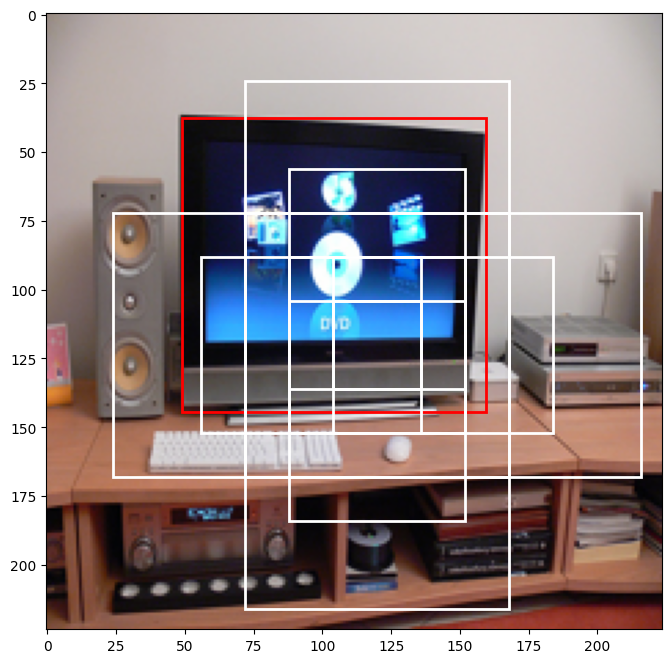

In [ ]:
# Take the anchors in the middle
no_anchors = anchors_tensor_min_xywh.shape[1]
half_anchors_index = no_anchors // 2 + 7*9
anchors_to_plot = anchors_tensor_min_xywh[0, half_anchors_index:half_anchors_index+9, :].numpy()
anchors_to_plot = [anchors_to_plot[i] for i in range(anchors_to_plot.shape[0])]

# Visualize the image
fig, ax = plt.subplots(1, figsize=(8, 8))  # Use figsize to set the size of the plot
ax.imshow(img_0)

# Plot bounding boxes
for bbox in img_0_bboxes:
    x_min, y_min, width, length = bbox
    rect = patches.Rectangle((x_min, y_min), width, length, linewidth=2, edgecolor='r', facecolor='none')
    ax.add_patch(rect)
# Plot anchors
for bbox in anchors_to_plot:
    x_min, y_min, width, length = bbox *224
    rect = patches.Rectangle((x_min, y_min), width, length, linewidth=2, edgecolor='w', facecolor='none')
    ax.add_patch(rect)

plt.show()

In [ ]:
# After creating the anchors, we can finally create our Y vector for the regression branch
# At first we calculate the IoU between anchors and images ground truth bounding boxes

def compute_iou(bboxes):
    # Compute the IoU for bounding boxes against ground truth
    iou = keras_cv.bounding_box.compute_iou(
        anchors_tensor_min_xywh,
        bboxes/224, #the boxes are not normalized
        "xyWH",
    )
    return iou

train_iou = []
for bbox in train_bounding_boxes:
    train_iou.append(compute_iou(bbox))

val_iou = []
for bbox in val_bounding_boxes:
    val_iou.append(compute_iou(bbox))

test_iou = []
for bbox in test_bounding_boxes:
    test_iou.append(compute_iou(bbox))


In [ ]:
# Let's test the results:
print(tf.argmax(test_iou[index], axis = 1))
print(tf.reduce_max(test_iou[index], axis = 1))
# As we can see, the best anchors have a decent IoU score

tf.Tensor([[689]], shape=(1, 1), dtype=int64)
tf.Tensor([[0.7834042]], shape=(1, 1), dtype=float32)


Now we need to create the classification labels that are used 1) for classification 2) to mask the regression loss.

In [ ]:
def create_classification_mask(iou_tensor, bboxes):
    # Now we create a tensor of closest gt bboxes for each of the anchors
    argmax_indices = tf.argmax(iou_tensor, axis = 2)
    gt_bboxes = tf.gather(bboxes, argmax_indices, axis = 1)
    gt_bboxes = tf.squeeze(gt_bboxes, 0)
    gt_bboxes = tf.cast(gt_bboxes, tf.float32) / 224 # Normalize

    # Create a mask for anchors that surpass 0.7 of IoU
    reduced_iou = tf.reduce_max(iou_tensor, axis = 2)
    iou_positive_score_mask = tf.cast(tf.greater(reduced_iou, 0.7), tf.float32)

    # We also want to add a mask for the best IoU scores
    argmax_indices2 = tf.argmax(iou_tensor, axis = 1)
    # Create a mask for the argmax
    best_iou_mask = tf.one_hot(argmax_indices2, depth=tf.shape(iou_positive_score_mask)[1], axis = 1)
    best_iou_mask = tf.reduce_sum(best_iou_mask, axis = 2)
    best_iou_mask = tf.clip_by_value(best_iou_mask, 0, 1) # There could be multiple best labels per anchor

    # Then, we merge the two masks and concatenate to the gt bboxes
    gt_mask = best_iou_mask + iou_positive_score_mask
    gt_mask = tf.expand_dims(gt_mask, -1)

    # Create a negative mask for the classification branch
    iou_negative_score_mask = tf.cast(tf.less(reduced_iou, 0.3), tf.float32)

    # Sample from the negative mask
    anchors_sample_size = 100 # We are only using 100 anchors per each image
    no_positive_samples = gt_mask.numpy().sum().astype(int)
    no_negative_samples = anchors_sample_size-no_positive_samples
    true_indices = tf.where(tf.equal(iou_negative_score_mask, 1))
    shuffled_indices = tf.random.shuffle(true_indices)
    selected_indices = shuffled_indices[:no_negative_samples]
    # Create a new mask with zeros everywhere except for those indices
    new_negative_mask = tf.zeros_like(iou_negative_score_mask)
    new_negative_mask = tf.tensor_scatter_nd_update(new_negative_mask, selected_indices, tf.ones(tf.shape(selected_indices)[0]))

    # Return the Y tensor for classification
    Y_cls = tf.concat([tf.expand_dims(new_negative_mask, 2), gt_mask], axis = 2)
    return Y_cls, gt_bboxes, gt_mask #we need the gt_bboxes and gt_mask for the regression tensor

# Test
cls_mask_test, gt_bboxes_test, gt_mask_test = create_classification_mask(test_iou[index], np.expand_dims(test_bounding_boxes[index], 0))
print(cls_mask_test.numpy().shape)
print(gt_bboxes_test.numpy().shape)
print(cls_mask_test.numpy().sum(axis = 1))
# Success!

(1, 1764, 2)
(1, 1764, 4)
[[98.  2.]]


In [ ]:
def create_regression_tensor(gt_bboxes, gt_mask):
    """
    The regression tensor will be made by the ground truth values (B, -1, 4),
    the mask (B, -1, 1) for positive labels,
    and the anchors (B, -1, 4),
    all concatenated.
    """
    # Return Y tensor for regression
    Y_reg = tf.concat([gt_bboxes, gt_mask, anchors_tensor_min_xywh], axis = -1)
    return Y_reg

create_regression_tensor(gt_bboxes_test, gt_mask_test)
# It works!

<tf.Tensor: shape=(1, 1764, 9), dtype=float32, numpy=
array([[[ 0.2191    ,  0.16815999,  0.49214   , ..., -0.        ,
          0.        ,  0.        ],
        [ 0.2191    ,  0.16815999,  0.49214   , ..., -0.        ,
          0.        ,  0.        ],
        [ 0.2191    ,  0.16815999,  0.49214   , ..., -0.        ,
          0.        ,  0.        ],
        ...,
        [ 0.2191    ,  0.16815999,  0.49214   , ...,  0.        ,
          0.        ,  0.        ],
        [ 0.2191    ,  0.16815999,  0.49214   , ...,  0.        ,
          0.        ,  0.        ],
        [ 0.2191    ,  0.16815999,  0.49214   , ...,  0.        ,
          0.        ,  0.        ]]], dtype=float32)>

Now we can finally create our target variables for the RPN head!

In [ ]:
train_Y_cls = []
train_Y_reg = []
val_Y_cls = []
val_Y_reg = []
test_Y_cls = []
test_Y_reg = []

for iou, bboxes in zip(train_iou, train_bounding_boxes):
    Y_cls, gt_bboxes, gt_mask = create_classification_mask(iou, np.expand_dims(bboxes, 0))
    Y_reg = create_regression_tensor(gt_bboxes, gt_mask)
    train_Y_cls.append(Y_cls)
    train_Y_reg.append(Y_reg)

for iou, bboxes in zip(val_iou, val_bounding_boxes):
    Y_cls, gt_bboxes, gt_mask = create_classification_mask(iou, np.expand_dims(bboxes, 0))
    Y_reg = create_regression_tensor(gt_bboxes, gt_mask)
    val_Y_cls.append(Y_cls)
    val_Y_reg.append(Y_reg)

for iou, bboxes in zip(test_iou, test_bounding_boxes):
    Y_cls, gt_bboxes, gt_mask = create_classification_mask(iou, np.expand_dims(bboxes, 0))
    Y_reg = create_regression_tensor(gt_bboxes, gt_mask)
    test_Y_cls.append(Y_cls)
    test_Y_reg.append(Y_reg)

train_Y_cls = tf.concat(train_Y_cls, axis = 0)
train_Y_reg = tf.concat(train_Y_reg, axis = 0)
val_Y_cls = tf.concat(val_Y_cls, axis = 0)
val_Y_reg = tf.concat(val_Y_reg, axis = 0)
test_Y_cls = tf.concat(test_Y_cls, axis = 0)
test_Y_reg = tf.concat(test_Y_reg, axis = 0)

print(train_Y_cls.shape)

(2838, 1764, 2)


Let's try to visualize the intermediate results.

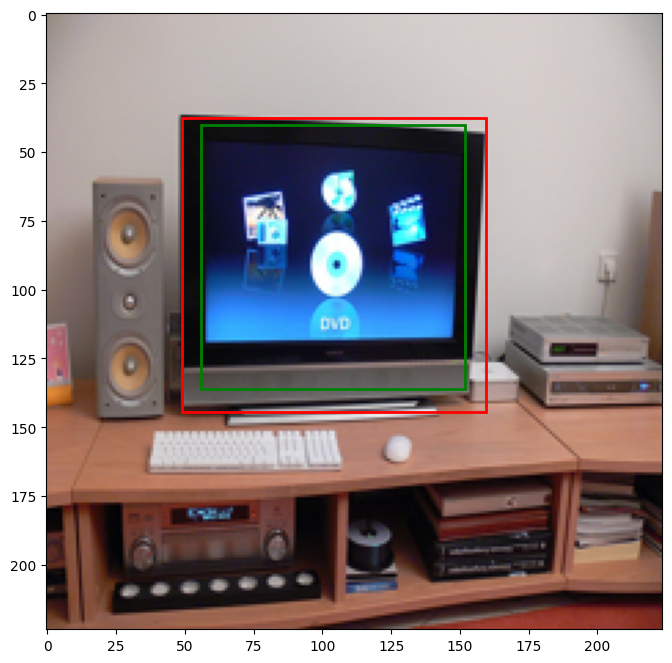

In [ ]:
# Best anchor
anchors_to_plot = [anchors_tensor_min_xywh[0, 689, :].numpy()]

# Visualize the image
fig, ax = plt.subplots(1, figsize=(8, 8))  # Use figsize to set the size of the plot
ax.imshow(img_0)

# Plot bounding boxes
for bbox in img_0_bboxes:
    x_min, y_min, width, length = bbox
    rect = patches.Rectangle((x_min, y_min), width, length, linewidth=2, edgecolor='r', facecolor='none')
    ax.add_patch(rect)
# Plot anchors
for bbox in anchors_to_plot:
    x_min, y_min, width, length = bbox *224
    rect = patches.Rectangle((x_min, y_min), width, length, linewidth=2, edgecolor='g', facecolor='none')
    ax.add_patch(rect)

plt.show() # Nice!

## RPN head and loss function

In [ ]:
# Build RPN Head
# At first we reduce by roughly half the map stack
rpn_conv = layers.Conv2D(256, (1, 1), activation='relu', padding='same')(backbone_output)

# Then we create the classification and regression ouputs
rpn_class = layers.Conv2D(k * 2, (1, 1), activation='linear', kernel_initializer = VarianceScaling(0.01), name='rpn_class')(rpn_conv)
rpn_reg = layers.Conv2D(k * 4, (1, 1), activation='linear', kernel_initializer = VarianceScaling(0.01), name='rpn_reg')(rpn_conv)

# Build RPN Model
rpn_model = models.Model(inputs=input, outputs=[rpn_class, rpn_reg])

# Show its structure
rpn_model.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_1 (InputLayer)        [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 Conv1 (Conv2D)              (None, 112, 112, 32)         864       ['input_1[0][0]']             
                                                                                                  
 bn_Conv1 (BatchNormalizati  (None, 112, 112, 32)         128       ['Conv1[0][0]']               
 on)                                                                                              
                                                                                                  
 Conv1_relu (ReLU)           (None, 112, 112, 32)         0         ['bn_Conv1[0][0]']      

Now the most important part: the loss function.

In [ ]:
# Explore the output of the model
out = rpn_model(train_np[:100])
cls = out[0]
reg = out[1]
print(cls.shape, reg.shape)

# Reshape the outputs
reg = tf.reshape(reg, (-1, 1764, 4))
print(reg.shape, train_Y_reg[:100].shape)

cls = tf.reshape(cls, (-1, 1764, 2))
print(cls.shape, train_Y_cls[:100].shape)

(100, 14, 14, 18) (100, 14, 14, 36)
(100, 1764, 4) (100, 1764, 9)
(100, 1764, 2) (100, 1764, 2)


In [ ]:
# It is important that weights are initialized correctly
reg[0, 0]

<tf.Tensor: shape=(4,), dtype=float32, numpy=array([ 0.02603667,  0.07471003, -0.07463162,  0.11308633], dtype=float32)>

In [ ]:
from keras.losses import Huber, binary_crossentropy, categorical_crossentropy

def rpn_reg_loss(y_true, y_pred):
    """
    The original implementation has been commented out, as we deemed it unnecessary.
    We propose a slight varation that is not as complicated.
    """
    # Split the y_true tensor
    gt_x = y_true[:, :, 0]
    gt_y = y_true[:, :, 1]
    gt_w = y_true[:, :, 2]
    gt_h = y_true[:, :, 3]
    mask = tf.tile(y_true[:, :, 4], (1, 4))
    anchors_x = y_true[:, :, 5]
    anchors_y = y_true[:, :, 6]
    anchors_w = y_true[:, :, 7]
    anchors_h = y_true[:, :, 8]

    # Reshape the predictions and manipulate targets
    pred_reg = tf.reshape(y_pred, (-1, 1764, 4)) # fun fact: if you write (batch_size, -1, 4) the val set breaks the training
    pred_reg_x = pred_reg[:, :, 0] # (pred_reg[:, :, 0] - anchors_x) / anchors_w
    pred_reg_y = pred_reg[:, :, 1] # (pred_reg[:, :, 1] - anchors_y) / anchors_h
    pred_reg_w = pred_reg[:, :, 2] # tf.math.log(pred_reg[:, :, 2] / anchors_w)
    pred_reg_h = pred_reg[:, :, 3] # tf.math.log(pred_reg[:, :, 3] / anchors_h)
    pred_reg_tot = tf.concat([pred_reg_x, pred_reg_y, pred_reg_w, pred_reg_h], axis = 1)
    pred_reg_tot *= mask

    # Manipulate gt
    gt_x = gt_x - anchors_x #(gt_x - anchors_x) / anchors_w
    gt_y = gt_y - anchors_y #(gt_y - anchors_y) / anchors_h
    gt_w = gt_w - anchors_w #tf.math.log(gt_w / anchors_w)
    gt_h = gt_h - anchors_h #tf.math.log(gt_h / anchors_h)
    gt_tot = tf.concat([gt_x, gt_y, gt_w, gt_h], axis = 1)
    gt_tot *= mask

    # Call the loss and return it
    huber_loss = Huber(delta = 0.1)
    loss = huber_loss(gt_tot, pred_reg_tot)
    return loss

def rpn_cls_loss(y_true, y_pred):
    # Reshape the tensors
    pred_cls = tf.reshape(y_pred, (-1, 1764, 2))

    # Mask the vectors
    mask = tf.clip_by_value(y_true[:, :, 0] + y_true[:, :, 1], 0, 1)
    mask = tf.expand_dims(mask, 2)
    y_true_input = mask*y_true
    y_pred_input = mask*pred_cls

    # Call the loss and return it
    loss = binary_crossentropy(y_true_input, y_pred_input, from_logits = True)
    return loss

## Training and evaluation

I am not sure they work, but let's find out!

In [ ]:
rpn_model.compile(optimizer=Adam(learning_rate = 0.001), loss = [rpn_cls_loss, rpn_reg_loss], loss_weights = [1, 10])

# Train the model
history = rpn_model.fit(
    x = train_np,
    y = [train_Y_cls, train_Y_reg],
    batch_size = 3,
    epochs = 50,
    validation_data = (val_np, [val_Y_cls, val_Y_reg]),
    callbacks = [callbacks.EarlyStopping(monitor='val_loss', mode='min', patience=100, restore_best_weights=True)]
).history

Epoch 1/50
Tensor("rpn_reg_loss/mul:0", shape=(3, 7056), dtype=float32)
Tensor("rpn_reg_loss/mul:0", shape=(3, 7056), dtype=float32)
946/946 [==============================] - 41s 26ms/step - loss: 0.6585 - rpn_class_loss: 0.6584 - rpn_reg_loss: 9.8464e-06 - val_loss: 0.6583 - val_rpn_class_loss: 0.6582 - val_rpn_reg_loss: 8.5908e-06
Epoch 2/50
946/946 [==============================] - 25s 27ms/step - loss: 0.6576 - rpn_class_loss: 0.6575 - rpn_reg_loss: 7.6092e-06 - val_loss: 0.6580 - val_rpn_class_loss: 0.6579 - val_rpn_reg_loss: 8.6020e-06
Epoch 3/50
946/946 [==============================] - 26s 28ms/step - loss: 0.6567 - rpn_class_loss: 0.6565 - rpn_reg_loss: 1.9677e-05 - val_loss: 0.6573 - val_rpn_class_loss: 0.6572 - val_rpn_reg_loss: 1.3606e-05
Epoch 4/50
946/946 [==============================] - 23s 24ms/step - loss: 0.6342 - rpn_class_loss: 0.6328 - rpn_reg_loss: 1.4213e-04 - val_loss: 0.6189 - val_rpn_class_loss: 0.6158 - val_rpn_reg_loss: 3.1019e-04
Epoch 5/50
946/946 [==

The network is working! This a remarkable result! However, it seems that the validation loss is not behaving properly. On top of it, the regression loss going in the wrong direction.

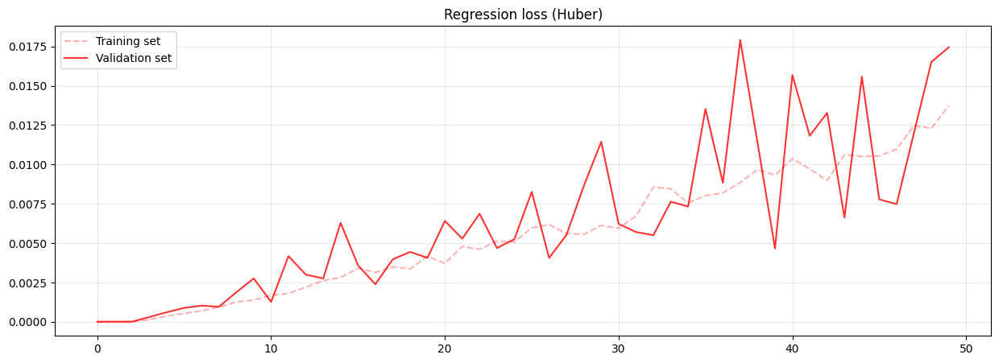

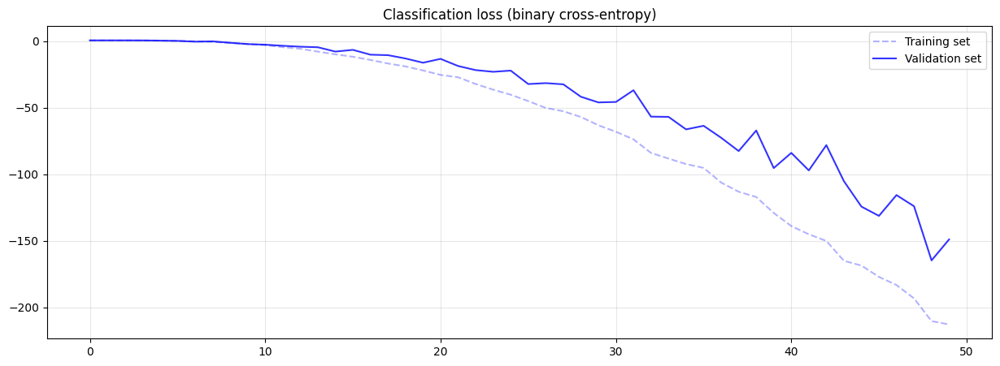

In [ ]:
plt.figure(figsize=(15,5))
plt.plot(history['rpn_reg_loss'], label='Training set', alpha=.3, color='r', linestyle='--')
plt.plot(history['val_rpn_reg_loss'], label='Validation set', alpha=.8, color='r')
plt.title('Regression loss (Huber)')
plt.grid(alpha=.3)
plt.legend()

plt.figure(figsize=(15,5))
plt.plot(history['rpn_class_loss'], label='Training set', alpha=.3, color='b', linestyle='--')
plt.plot(history['val_rpn_class_loss'], label='Validation set', alpha=.8, color='b')
plt.title('Classification loss (binary cross-entropy)')
plt.grid(alpha=.3)
plt.legend()

plt.show()

More regularization is needed: let's try again by decreasing the learning rate, increasing the batch size and adding a dropout layer.

...

After several tries, we realized that the reason why the regression loss is so far off, is that the classification loss is logarithmic, and the regression loss is linear! To have a similar backpropagation we need them to both be linear (or logarithmic)!

In [ ]:
# wrapper around the loss function
def rpn_reg_loss_log(y_true, y_pred):
    return tf.math.log(rpn_reg_loss(y_true, y_pred))

In [ ]:
# Build RPN Head
# At first we reduce by roughly half the map stack
rpn_conv = layers.Conv2D(256, (1, 1), activation='relu', padding='same')(backbone_output)

# Add a dropout layer with 50% dropout rate
# dropout = layers.Dropout(0.5)(rpn_conv)

# Then we create the classification and regression ouputs
rpn_class = layers.Conv2D(k * 2, (1, 1), activation='linear', kernel_initializer = VarianceScaling(0.01), name='rpn_class')(rpn_conv)
rpn_reg = layers.Conv2D(k * 4, (1, 1), activation='linear', kernel_initializer = VarianceScaling(0.01), name='rpn_reg')(rpn_conv)

# Build RPN Model
rpn_model2 = models.Model(inputs=input, outputs=[rpn_class, rpn_reg])

# We incease the learning rate and increase the weight of the class loss
rpn_model2.compile(optimizer=Adam(learning_rate = 0.1), loss = [rpn_cls_loss, rpn_reg_loss_log], loss_weights = [10, 1])

# Train the model
history = rpn_model2.fit(
    x = train_np,
    y = [train_Y_cls, train_Y_reg],
    batch_size = 12,
    epochs = 50,
    validation_data = (val_np, [val_Y_cls, val_Y_reg]),
    callbacks = [callbacks.EarlyStopping(monitor='val_loss', mode='min', patience=100, restore_best_weights=True)]
).history

Epoch 1/50
237/237 [==============================] - 30s 54ms/step - loss: 53.8746 - rpn_class_loss: 0.6596 - rpn_reg_loss: -12.0836 - val_loss: 53.6224 - val_rpn_class_loss: 0.6590 - val_rpn_reg_loss: -12.2727
Epoch 2/50
237/237 [==============================] - 12s 50ms/step - loss: 53.4314 - rpn_class_loss: 0.6588 - rpn_reg_loss: -12.4495 - val_loss: 53.6253 - val_rpn_class_loss: 0.6589 - val_rpn_reg_loss: -12.2689
Epoch 3/50
237/237 [==============================] - 12s 51ms/step - loss: 53.3307 - rpn_class_loss: 0.6588 - rpn_reg_loss: -12.5500 - val_loss: 53.4996 - val_rpn_class_loss: 0.6590 - val_rpn_reg_loss: -12.3968
Epoch 4/50
237/237 [==============================] - 12s 51ms/step - loss: 53.3582 - rpn_class_loss: 0.6588 - rpn_reg_loss: -12.5225 - val_loss: 53.6006 - val_rpn_class_loss: 0.6589 - val_rpn_reg_loss: -12.2913
Epoch 5/50
237/237 [==============================] - 12s 49ms/step - loss: 53.4153 - rpn_class_loss: 0.6588 - rpn_reg_loss: -12.4658 - val_loss: 53.676

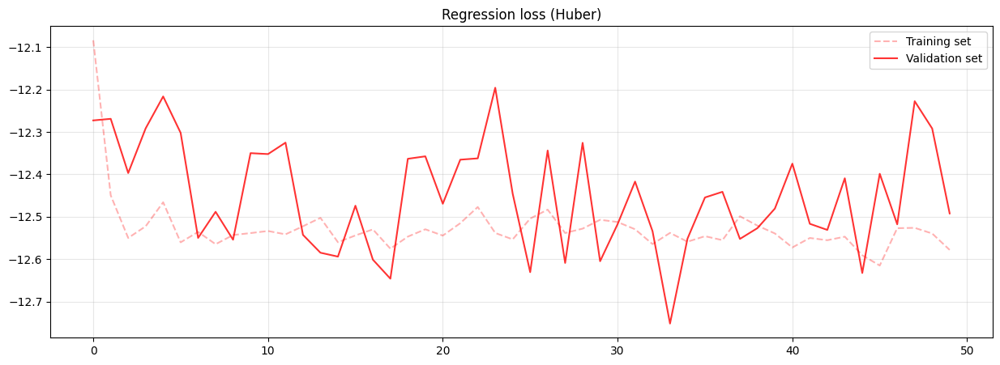

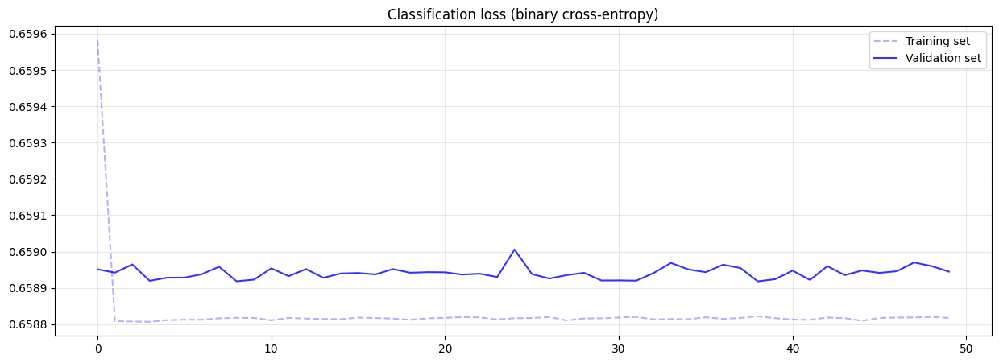

In [ ]:
plt.figure(figsize=(15,5))
plt.plot(history['rpn_reg_loss'], label='Training set', alpha=.3, color='r', linestyle='--')
plt.plot(history['val_rpn_reg_loss'], label='Validation set', alpha=.8, color='r')
plt.title('Regression loss (Huber)')
plt.grid(alpha=.3)
plt.legend()

plt.figure(figsize=(15,5))
plt.plot(history['rpn_class_loss'], label='Training set', alpha=.3, color='b', linestyle='--')
plt.plot(history['val_rpn_class_loss'], label='Validation set', alpha=.8, color='b')
plt.title('Classification loss (binary cross-entropy)')
plt.grid(alpha=.3)
plt.legend()

plt.show()

Since we decreased its weight, the results are not better for the classification loss, but we are still not yet there for the regression either!

In [ ]:
# Visualize the first prediction
cls, reg = rpn_model2.predict(tf.expand_dims(img_0, axis = 0))
print(cls.shape, reg.shape)

# Reshape the regression ouput
reg = tf.reshape(reg, (1, -1, 4)) + anchors_tensor_min_xywh

# Create a mask
cls = tf.reshape(cls, (1, -1, 2))
cls = tf.math.softmax(cls, 2)
cls_mask = tf.math.round(cls[:, :, 1])
print(cls_mask.numpy().sum())

1/1 [==============================] - 2s 2s/step
(1, 14, 14, 18) (1, 14, 14, 36)
0.0


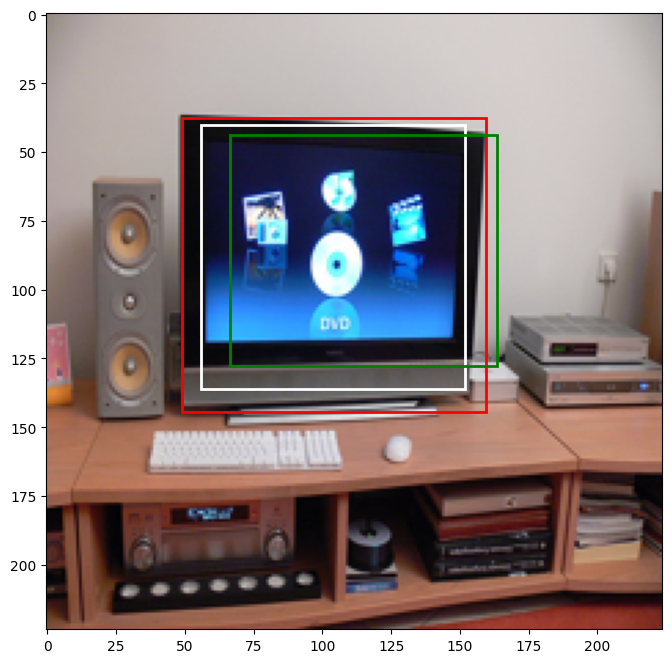

In [ ]:
# Best anchor
anchors_to_plot = [anchors_tensor_min_xywh[0, 689, :].numpy()]

# regression output
reg_to_plot = [reg[0, 689, :].numpy()]

# Visualize the image
fig, ax = plt.subplots(1, figsize=(8, 8))  # Use figsize to set the size of the plot
ax.imshow(img_0)

# Plot bounding boxes
for bbox in img_0_bboxes:
    x_min, y_min, width, length = bbox
    rect = patches.Rectangle((x_min, y_min), width, length, linewidth=2, edgecolor='r', facecolor='none')
    ax.add_patch(rect)
# Plot anchors
for bbox in anchors_to_plot:
    x_min, y_min, width, length = bbox *224
    rect = patches.Rectangle((x_min, y_min), width, length, linewidth=2, edgecolor='w', facecolor='none')
    ax.add_patch(rect)

# Plot regression output
for bbox in reg_to_plot:
    x_min, y_min, width, length = bbox *224
    rect = patches.Rectangle((x_min, y_min), width, length, linewidth=2, edgecolor='g', facecolor='none')
    ax.add_patch(rect)

plt.show()

After tuning some more parameters, we came to the conclusion that we do not have enough images and bounding boxes per image to make the model converge. That is the reason why it would be better to fine tune a pre-trained model that has been trained on a lot of images and it is capable of proposing good regions.

Even if we put a lot of effort in this section, we are still constrained by memory and computational costs, so we will not move on with our Mask R-CNN implementation from scratch.

We hope that you could still appreciate our efforts. From our end, we enjoyed working on this - a lot! - and we are happy to have gained a lot of insights into Faster R-CNNs and Mask R-CNNs.

# U-Net

## Inputs and model

In [ ]:
# Changing categories 72, 73 to 1, 2
train_mask_np2 = np.clip(train_mask_np - 71, 0, 2)
val_mask_np2 = np.clip(val_mask_np - 71, 0, 2)
test_mask_np2 = np.clip(test_mask_np - 71, 0, 2)

In [ ]:
input_size = (224, 224, 3)
num_classes = 3
seed = 42

In [ ]:
def unet_block(input_tensor, filters, kernel_size=3, activation='relu', stack=2, name=''):

    x = input_tensor
    for i in range(stack):
        x = layers.Conv2D(filters, kernel_size=3, padding='same', name=name+'conv'+str(i+1))(x)
        x = layers.BatchNormalization(name=name+'bn'+str(i+1))(x)
        x = layers.Activation(activation, name=name+'activation'+str(i+1))(x)

    return x

In [ ]:
def get_unet_model(input_shape=input_size, num_classes=num_classes, seed=seed):
    tf.random.set_seed(seed)
    input_layer = layers.Input(shape=input_shape, name='input_layer')

    # First Downsampling
    down_block_1 = unet_block(input_layer, 64, name='down_block1_')
    d1 = layers.MaxPooling2D()(down_block_1)

    # Second Downsampling
    down_block_2 = unet_block(d1, 128, name='down_block2_')
    d2 = layers.MaxPooling2D()(down_block_2)

    # Third Downsampling
    down_block_3 = unet_block(d2, 256, name='down_block3_')
    d3 = layers.MaxPooling2D()(down_block_3)

    # Forth Downsampling
    down_block_4 = unet_block(d3, 512, name='down_block4_')
    d4 = layers.MaxPooling2D()(down_block_4)

    # Bottleneck
    bottleneck = unet_block(d4, 512, name='bottleneck')

    # First Upsampling
    u1 = layers.UpSampling2D()(bottleneck)
    u1 = layers.Add(name='add1')([u1,down_block_4])
    u1 = unet_block(u1, 256, name='up_block1_')

    # Second Upsampling
    u2 = layers.UpSampling2D()(u1)
    u2 = layers.Add(name='add2')([u2,down_block_3])
    u2 = unet_block(u2, 128, name='up_block2_')

    # Third Upsampling
    u3 = layers.UpSampling2D()(u2)
    u3 = layers.Add(name='add3')([u3,down_block_2])
    u3 = unet_block(u3, 64, name='up_block3_')

    # Forth Upsampling
    u4 = layers.UpSampling2D()(u3)
    u4 = layers.Add(name='add4')([u4,down_block_1])
    u4 = unet_block(u4, 64, name='up_block4_')

    # Output Layer
    output_layer = tf.keras.layers.Conv2D(num_classes, kernel_size=3, padding='same', activation="softmax", name='output_layer')(u4)

    model = tf.keras.Model(inputs=input_layer, outputs=output_layer)
    return model

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                Output Shape                 Param #   Connected to                  
 input_layer (InputLayer)    [(None, 224, 224, 3)]        0         []                            
                                                                                                  
 down_block1_conv1 (Conv2D)  (None, 224, 224, 64)         1792      ['input_layer[0][0]']         
                                                                                                  
 down_block1_bn1 (BatchNorm  (None, 224, 224, 64)         256       ['down_block1_conv1[0][0]']   
 alization)                                                                                       
                                                                                                  
 down_block1_activation1 (A  (None, 224, 224, 64)         0         ['down_block1_bn1[0][0]'] 

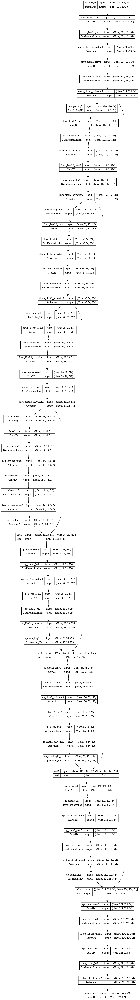

In [ ]:
model = get_unet_model()
model.summary()
tf.keras.utils.plot_model(model, show_shapes=True, expand_nested=True)

In [ ]:
# Define a custom metric class for mean intersection over union (IoU)
class UpdatedMeanIoU(tf.keras.metrics.MeanIoU):
    def __init__(self, num_classes=None, name="mean_iou", dtype=None):
        super(UpdatedMeanIoU, self).__init__(num_classes=num_classes, name=name, dtype=dtype)

    def update_state(self, y_true, y_pred, sample_weight=None):
        y_pred = tf.math.argmax(y_pred, axis=-1)
        return super().update_state(y_true, y_pred, sample_weight)

# Define a callback class for visualization during training
class VizCallback(tf.keras.callbacks.Callback):
    def __init__(self, image, label):
        super().__init__()
        self.image = image
        self.label = label

    def on_epoch_end(self, epoch, logs=None):
        # Predict using the model and visualize ground truth vs predicted mask
        pred = model.predict(self.image, verbose=0)
        y_pred = tf.math.argmax(pred, axis=-1)
        y_pred = np.array(y_pred)
        y_pred = np.reshape(y_pred, (224, 224, 1))
        fig, axes = plt.subplots(1, 2, figsize=(16, 4))
        axes[0].imshow(np.squeeze(self.label))
        axes[0].set_title("Ground Truth Mask")
        axes[1].imshow(np.squeeze(y_pred))
        axes[1].set_title("Predicted Mask")
        plt.tight_layout()
        plt.show()

## Training and inference

In [ ]:
learning_rate = 1e-3
batch_size = 16
epochs = 40 # One hour of training on a T4

In [ ]:
model.compile(
    loss = losses.SparseCategoricalCrossentropy(),
    optimizer = AdamW(learning_rate),
    metrics = ["accuracy", UpdatedMeanIoU(num_classes=num_classes)]
    )

patience = 30
early_stopping = callbacks.EarlyStopping(monitor='val_mean_iou', mode='max', patience=patience, restore_best_weights=True)
viz_callback = VizCallback(np.expand_dims(test_np[index],axis=0), np.expand_dims(test_mask_np2[index],axis=0))
scheduler = callbacks.ReduceLROnPlateau(monitor='val_mean_iou', mode='max', factor=0.1, patience=patience-5, min_lr=1e-5)

Epoch 1/40


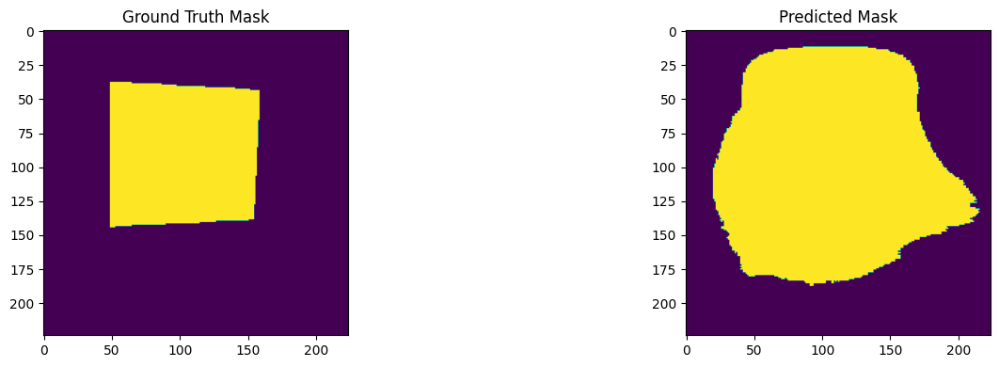

178/178 - 123s - loss: 0.4434 - accuracy: 0.8661 - mean_iou: 0.3101 - val_loss: 0.9781 - val_accuracy: 0.6787 - val_mean_iou: 0.2698 - lr: 0.0010 - 123s/epoch - 691ms/step
Epoch 2/40


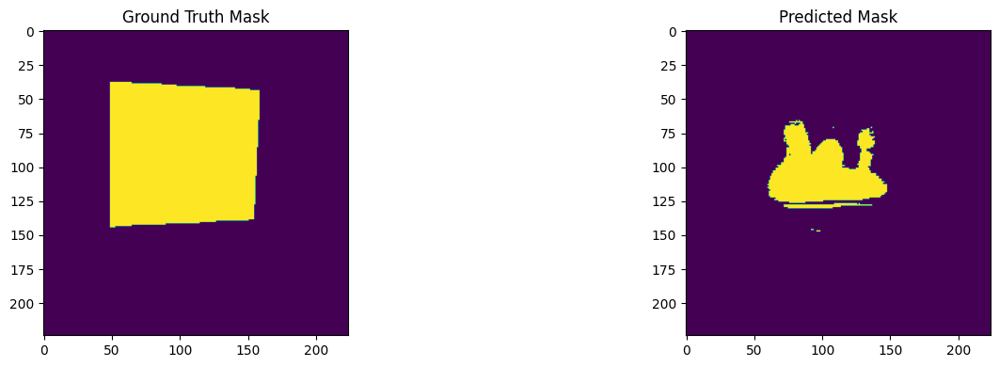

178/178 - 87s - loss: 0.4064 - accuracy: 0.8761 - mean_iou: 0.3167 - val_loss: 0.4472 - val_accuracy: 0.8718 - val_mean_iou: 0.3135 - lr: 0.0010 - 87s/epoch - 488ms/step
Epoch 3/40


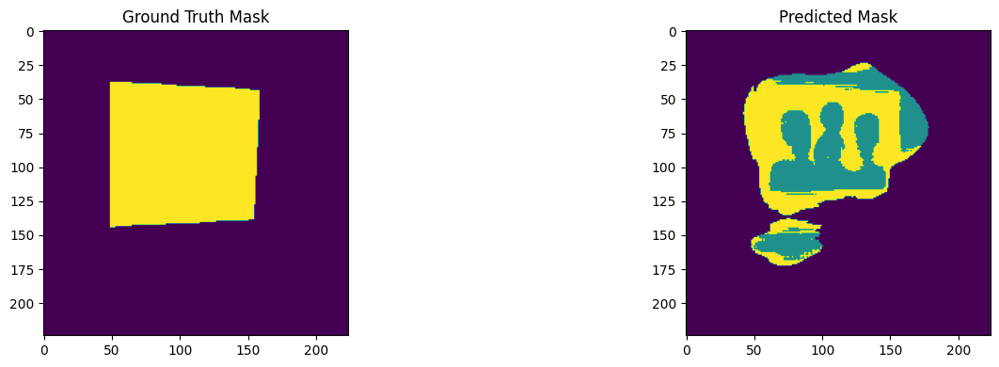

178/178 - 87s - loss: 0.3934 - accuracy: 0.8776 - mean_iou: 0.3253 - val_loss: 0.5231 - val_accuracy: 0.8403 - val_mean_iou: 0.3696 - lr: 0.0010 - 87s/epoch - 487ms/step
Epoch 4/40


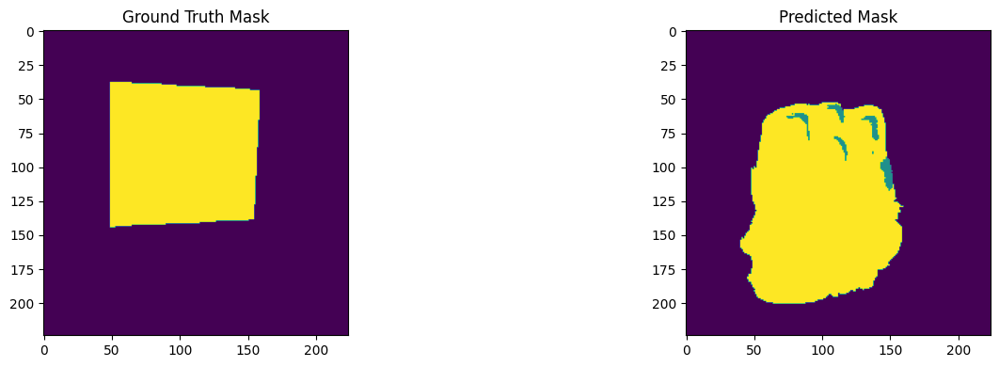

178/178 - 87s - loss: 0.3773 - accuracy: 0.8806 - mean_iou: 0.3461 - val_loss: 0.4699 - val_accuracy: 0.8545 - val_mean_iou: 0.3466 - lr: 0.0010 - 87s/epoch - 490ms/step
Epoch 5/40


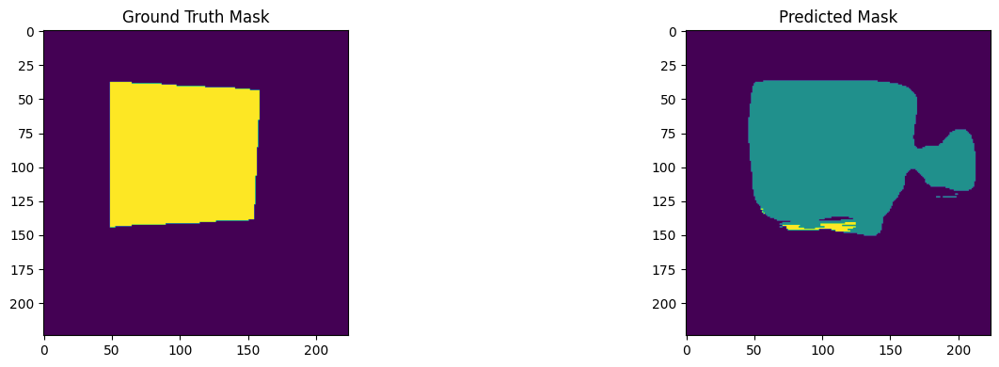

178/178 - 87s - loss: 0.3767 - accuracy: 0.8806 - mean_iou: 0.3491 - val_loss: 0.4693 - val_accuracy: 0.8362 - val_mean_iou: 0.3583 - lr: 0.0010 - 87s/epoch - 490ms/step
Epoch 6/40


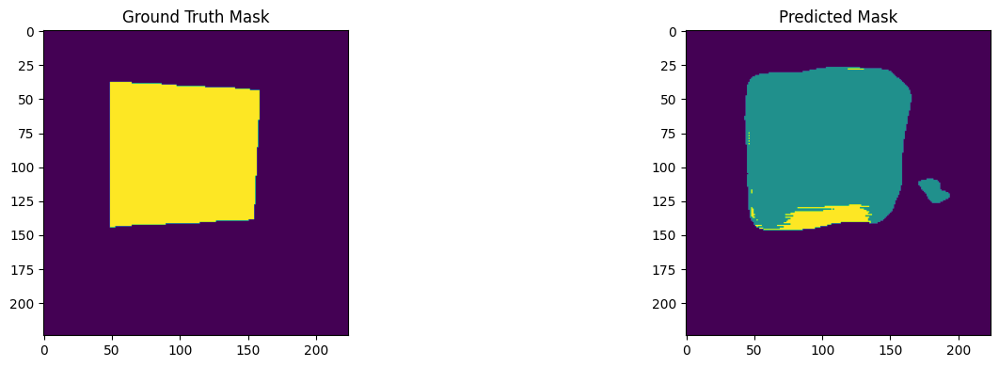

178/178 - 87s - loss: 0.3615 - accuracy: 0.8833 - mean_iou: 0.3655 - val_loss: 0.4330 - val_accuracy: 0.8565 - val_mean_iou: 0.3747 - lr: 0.0010 - 87s/epoch - 491ms/step
Epoch 7/40


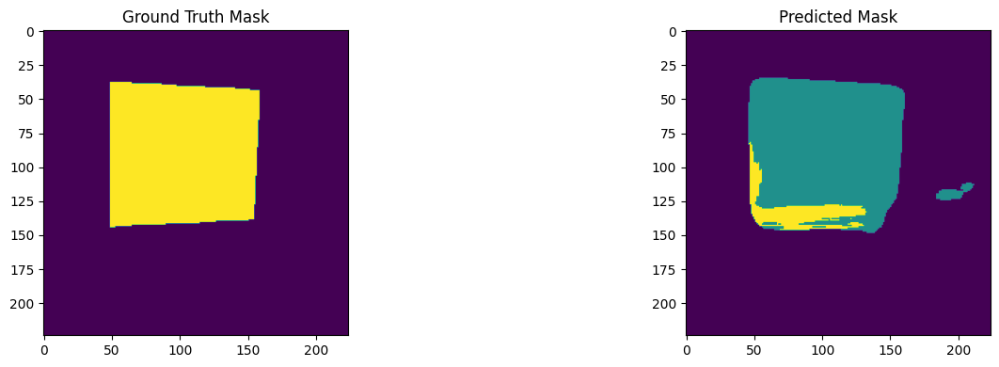

178/178 - 87s - loss: 0.3499 - accuracy: 0.8858 - mean_iou: 0.3807 - val_loss: 0.4015 - val_accuracy: 0.8684 - val_mean_iou: 0.3967 - lr: 0.0010 - 87s/epoch - 490ms/step
Epoch 8/40


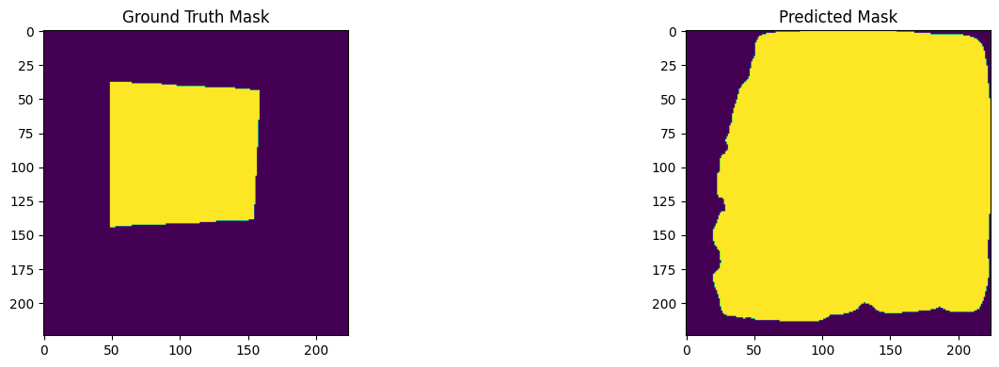

178/178 - 87s - loss: 0.3396 - accuracy: 0.8883 - mean_iou: 0.3973 - val_loss: 2.7672 - val_accuracy: 0.4840 - val_mean_iou: 0.1953 - lr: 0.0010 - 87s/epoch - 491ms/step
Epoch 9/40


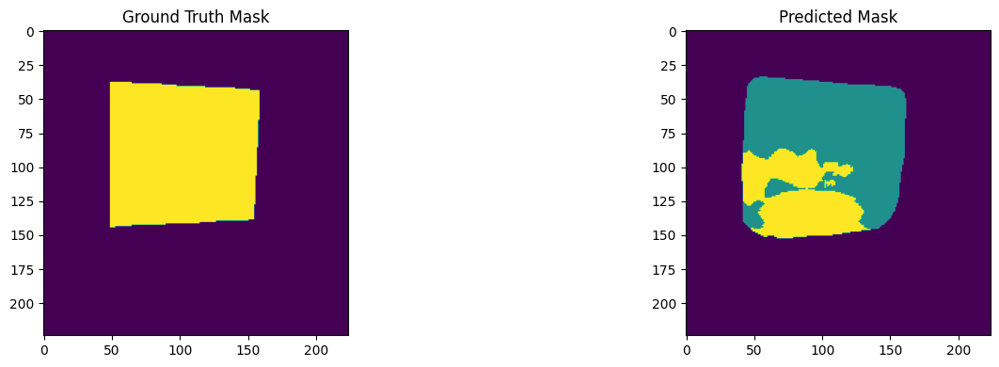

178/178 - 88s - loss: 0.3367 - accuracy: 0.8875 - mean_iou: 0.3957 - val_loss: 0.4018 - val_accuracy: 0.8612 - val_mean_iou: 0.4130 - lr: 0.0010 - 88s/epoch - 492ms/step
Epoch 10/40


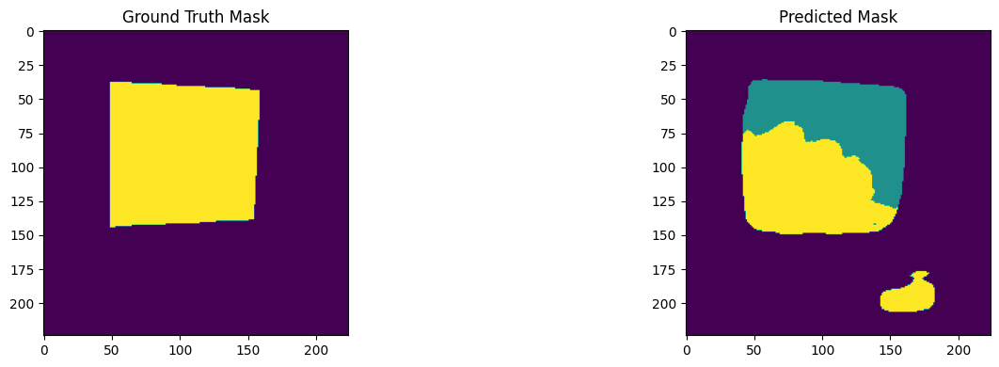

178/178 - 87s - loss: 0.3230 - accuracy: 0.8915 - mean_iou: 0.4180 - val_loss: 0.3690 - val_accuracy: 0.8684 - val_mean_iou: 0.4327 - lr: 0.0010 - 87s/epoch - 491ms/step
Epoch 11/40


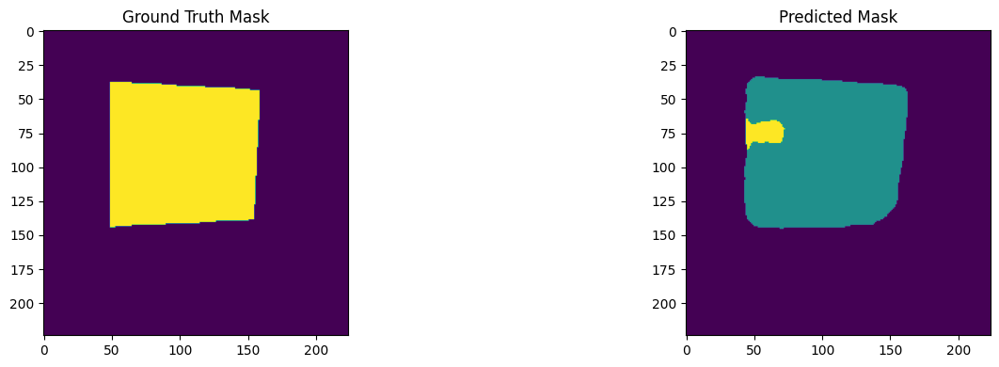

178/178 - 87s - loss: 0.3159 - accuracy: 0.8940 - mean_iou: 0.4332 - val_loss: 0.3567 - val_accuracy: 0.8790 - val_mean_iou: 0.4394 - lr: 0.0010 - 87s/epoch - 491ms/step
Epoch 12/40


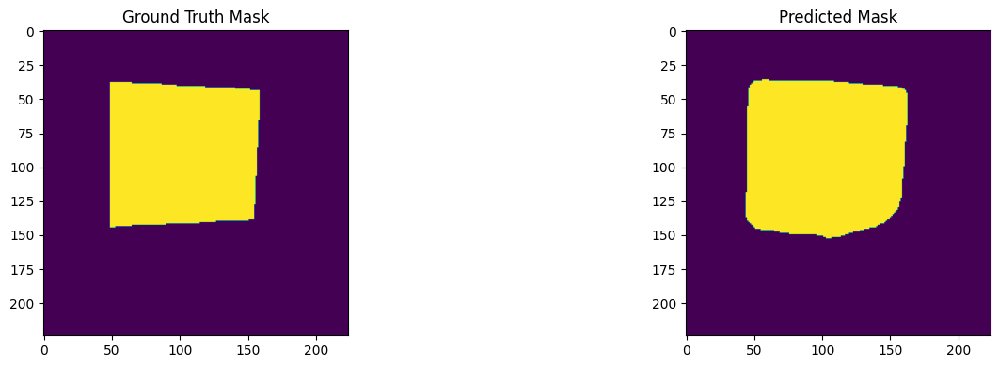

178/178 - 88s - loss: 0.3053 - accuracy: 0.8967 - mean_iou: 0.4502 - val_loss: 0.3981 - val_accuracy: 0.8628 - val_mean_iou: 0.4150 - lr: 0.0010 - 88s/epoch - 492ms/step
Epoch 13/40


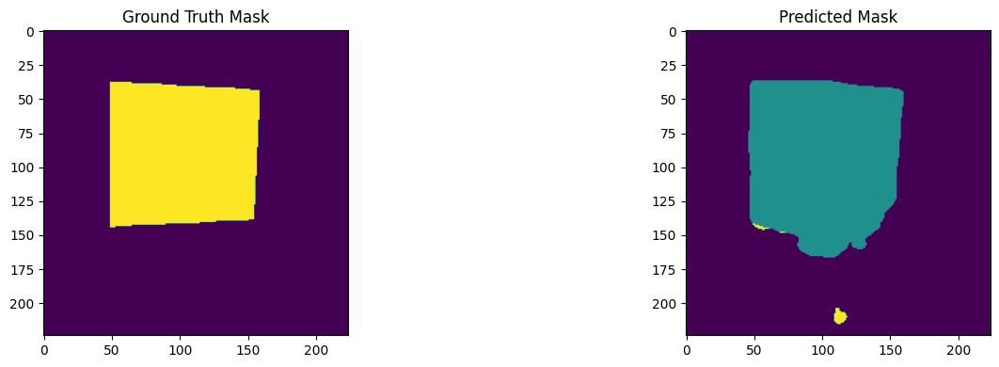

178/178 - 88s - loss: 0.2941 - accuracy: 0.9020 - mean_iou: 0.4712 - val_loss: 0.4299 - val_accuracy: 0.8554 - val_mean_iou: 0.4288 - lr: 0.0010 - 88s/epoch - 492ms/step
Epoch 14/40


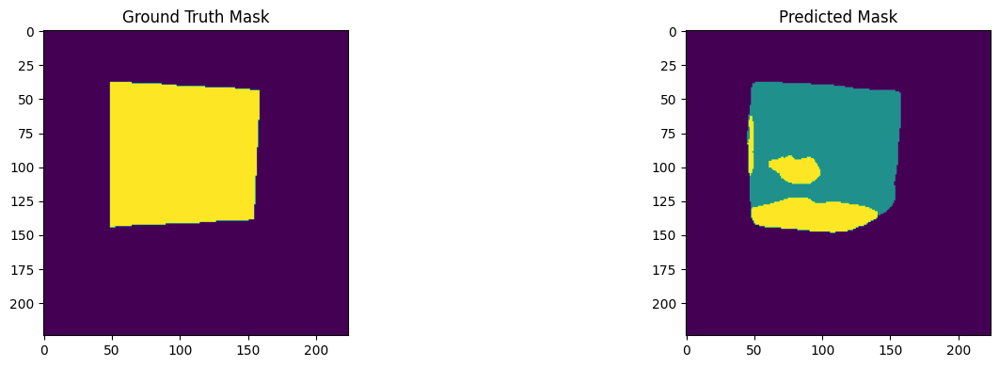

178/178 - 88s - loss: 0.2852 - accuracy: 0.9038 - mean_iou: 0.4839 - val_loss: 0.3351 - val_accuracy: 0.8956 - val_mean_iou: 0.4569 - lr: 0.0010 - 88s/epoch - 492ms/step
Epoch 15/40


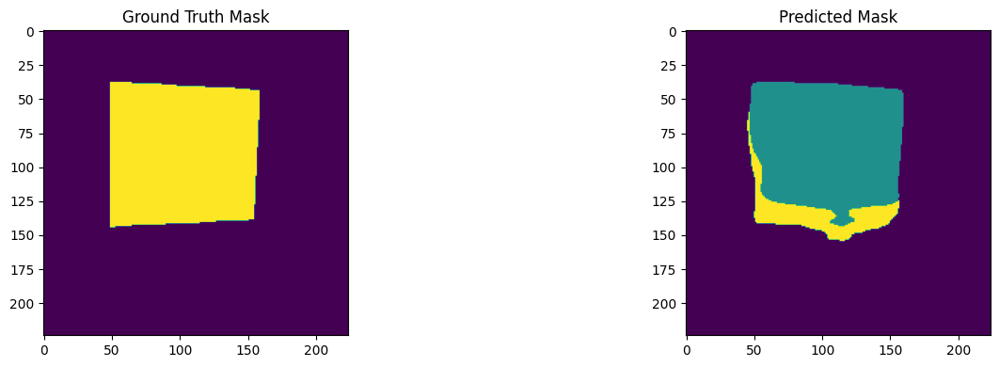

178/178 - 88s - loss: 0.2722 - accuracy: 0.9080 - mean_iou: 0.5027 - val_loss: 0.3275 - val_accuracy: 0.8934 - val_mean_iou: 0.4792 - lr: 0.0010 - 88s/epoch - 493ms/step
Epoch 16/40


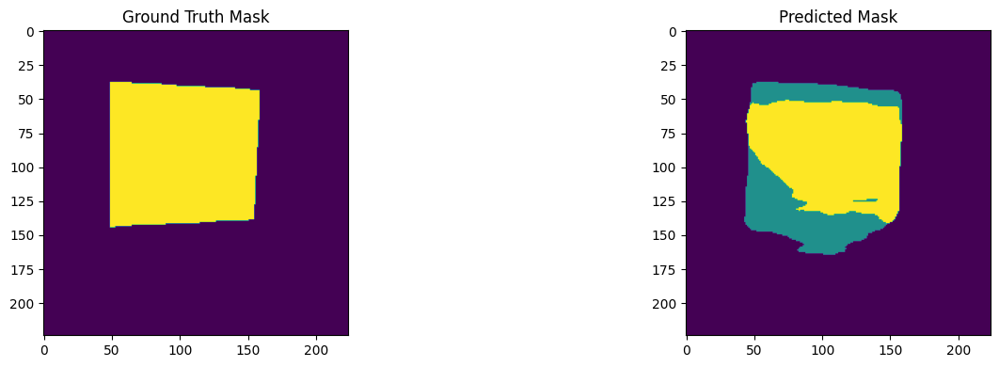

178/178 - 88s - loss: 0.2693 - accuracy: 0.9091 - mean_iou: 0.5119 - val_loss: 0.3349 - val_accuracy: 0.8852 - val_mean_iou: 0.4587 - lr: 0.0010 - 88s/epoch - 493ms/step
Epoch 17/40


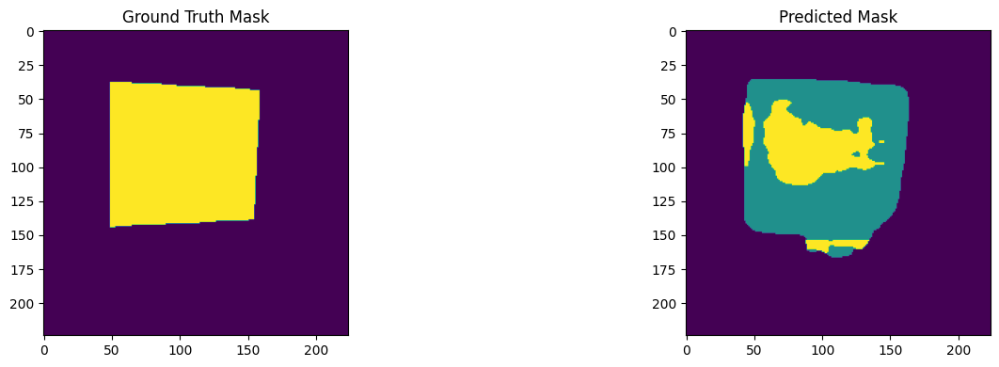

178/178 - 88s - loss: 0.2533 - accuracy: 0.9132 - mean_iou: 0.5353 - val_loss: 0.3217 - val_accuracy: 0.8881 - val_mean_iou: 0.5039 - lr: 0.0010 - 88s/epoch - 493ms/step
Epoch 18/40


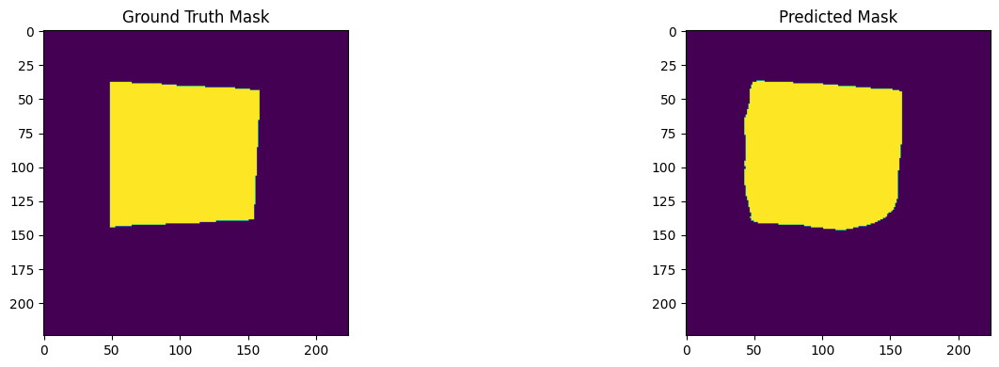

178/178 - 88s - loss: 0.2424 - accuracy: 0.9176 - mean_iou: 0.5551 - val_loss: 0.3247 - val_accuracy: 0.8993 - val_mean_iou: 0.4917 - lr: 0.0010 - 88s/epoch - 493ms/step
Epoch 19/40


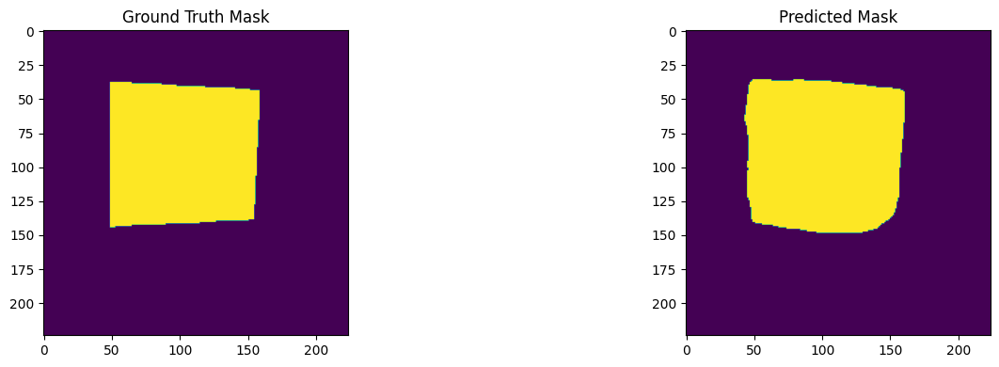

178/178 - 88s - loss: 0.2298 - accuracy: 0.9220 - mean_iou: 0.5755 - val_loss: 0.3350 - val_accuracy: 0.8999 - val_mean_iou: 0.4761 - lr: 0.0010 - 88s/epoch - 493ms/step
Epoch 20/40


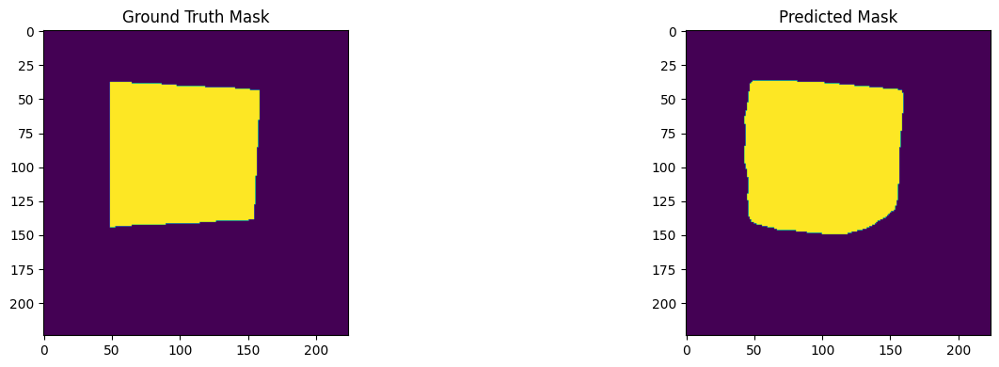

178/178 - 88s - loss: 0.2178 - accuracy: 0.9253 - mean_iou: 0.5955 - val_loss: 0.3137 - val_accuracy: 0.8996 - val_mean_iou: 0.4943 - lr: 0.0010 - 88s/epoch - 492ms/step
Epoch 21/40


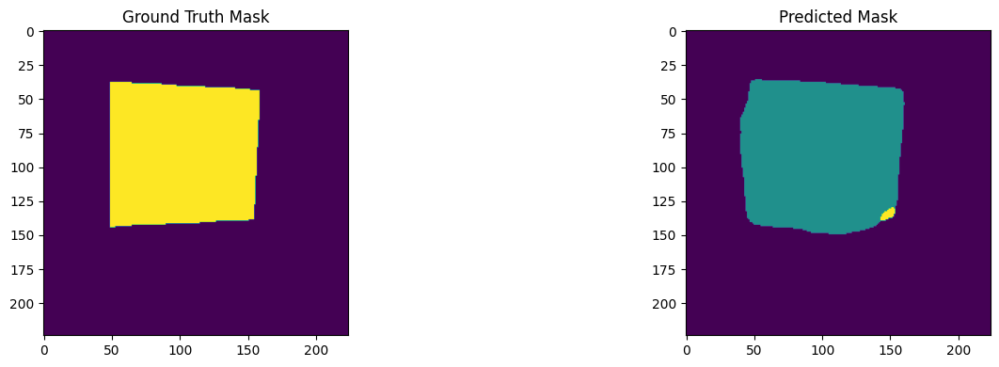

178/178 - 88s - loss: 0.2039 - accuracy: 0.9296 - mean_iou: 0.6160 - val_loss: 0.3198 - val_accuracy: 0.8991 - val_mean_iou: 0.5180 - lr: 0.0010 - 88s/epoch - 492ms/step
Epoch 22/40


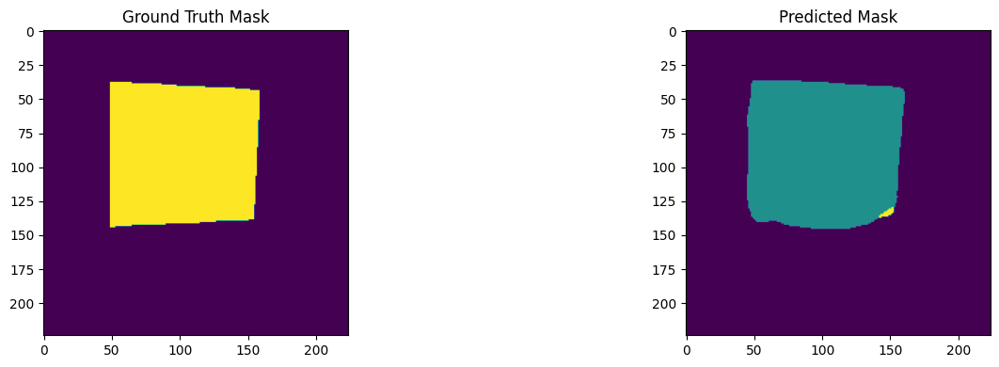

178/178 - 88s - loss: 0.1912 - accuracy: 0.9342 - mean_iou: 0.6383 - val_loss: 0.3149 - val_accuracy: 0.9061 - val_mean_iou: 0.5309 - lr: 0.0010 - 88s/epoch - 492ms/step
Epoch 23/40


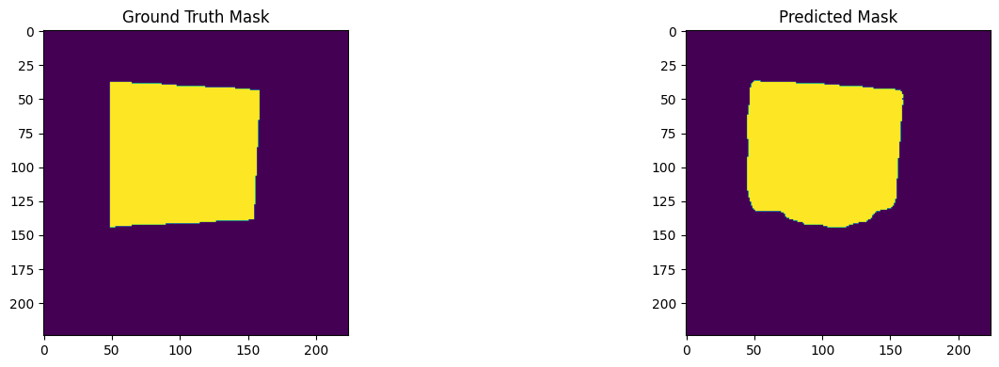

178/178 - 88s - loss: 0.1763 - accuracy: 0.9391 - mean_iou: 0.6625 - val_loss: 0.3160 - val_accuracy: 0.8997 - val_mean_iou: 0.5137 - lr: 0.0010 - 88s/epoch - 494ms/step
Epoch 24/40


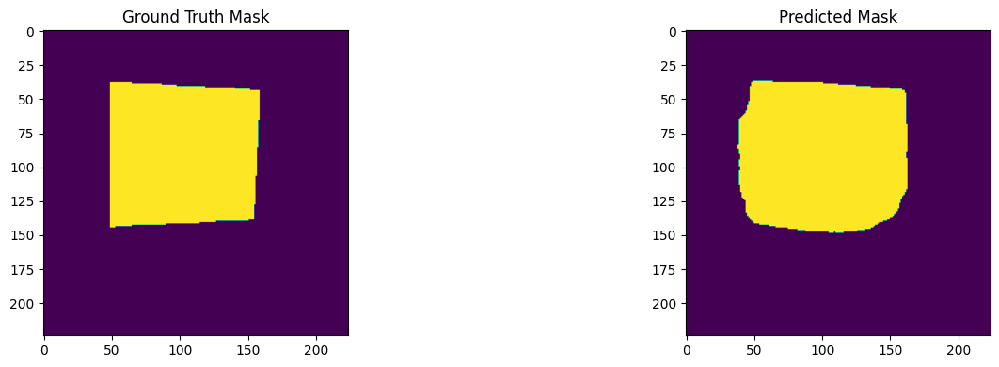

178/178 - 88s - loss: 0.1603 - accuracy: 0.9445 - mean_iou: 0.6903 - val_loss: 0.3690 - val_accuracy: 0.8810 - val_mean_iou: 0.5110 - lr: 0.0010 - 88s/epoch - 493ms/step
Epoch 25/40


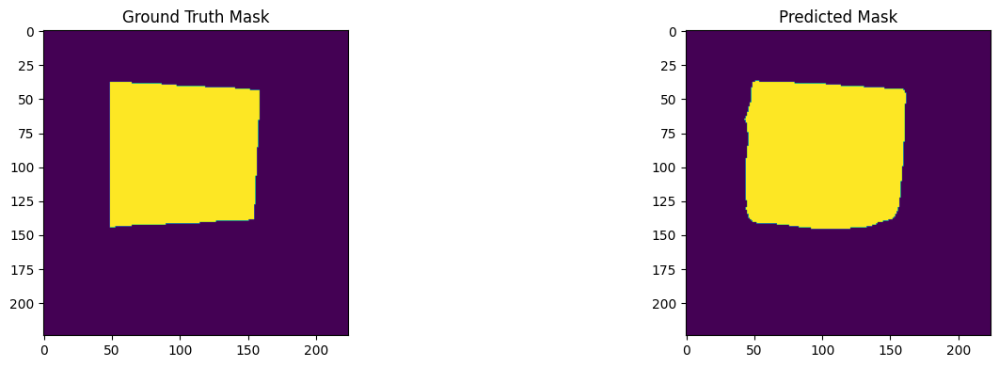

178/178 - 88s - loss: 0.1493 - accuracy: 0.9479 - mean_iou: 0.7085 - val_loss: 0.3486 - val_accuracy: 0.8986 - val_mean_iou: 0.4762 - lr: 0.0010 - 88s/epoch - 493ms/step
Epoch 26/40


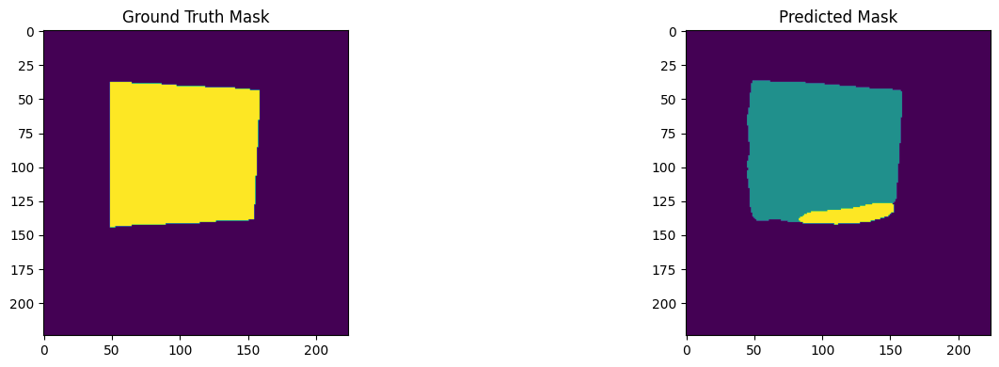

178/178 - 88s - loss: 0.1351 - accuracy: 0.9527 - mean_iou: 0.7352 - val_loss: 0.3988 - val_accuracy: 0.9058 - val_mean_iou: 0.5062 - lr: 0.0010 - 88s/epoch - 492ms/step
Epoch 27/40


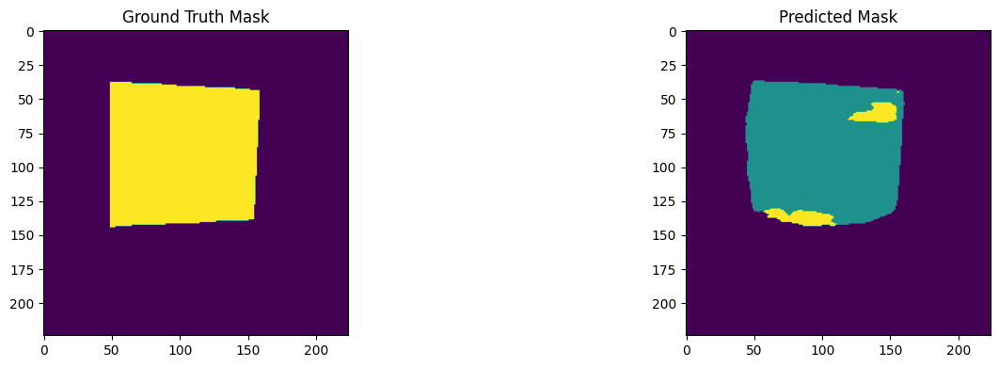

178/178 - 88s - loss: 0.1173 - accuracy: 0.9590 - mean_iou: 0.7648 - val_loss: 0.3663 - val_accuracy: 0.9084 - val_mean_iou: 0.5484 - lr: 0.0010 - 88s/epoch - 492ms/step
Epoch 28/40


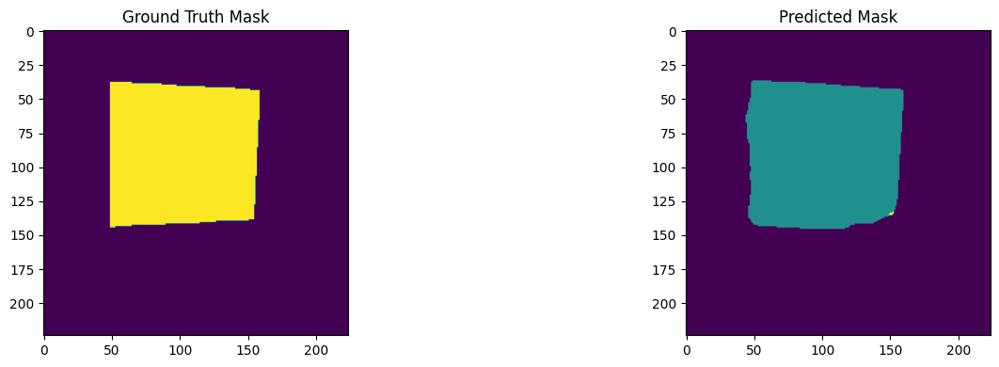

178/178 - 88s - loss: 0.0996 - accuracy: 0.9658 - mean_iou: 0.8048 - val_loss: 0.3959 - val_accuracy: 0.9099 - val_mean_iou: 0.5359 - lr: 0.0010 - 88s/epoch - 493ms/step
Epoch 29/40


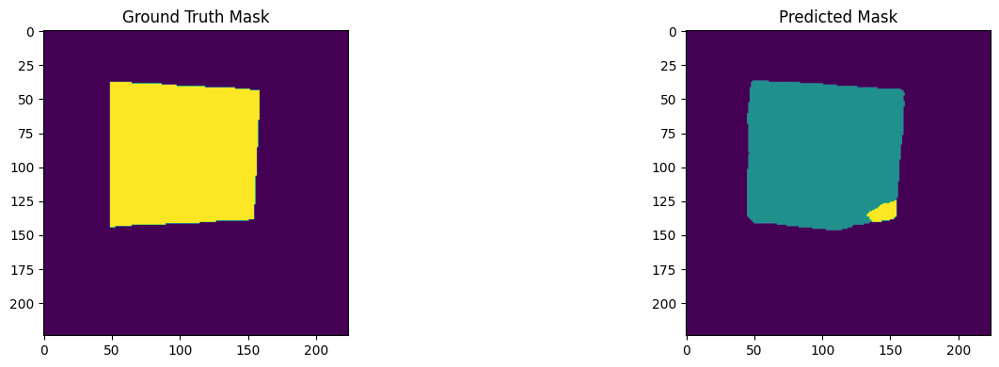

178/178 - 88s - loss: 0.0909 - accuracy: 0.9681 - mean_iou: 0.8171 - val_loss: 0.3763 - val_accuracy: 0.9035 - val_mean_iou: 0.5500 - lr: 0.0010 - 88s/epoch - 493ms/step
Epoch 30/40


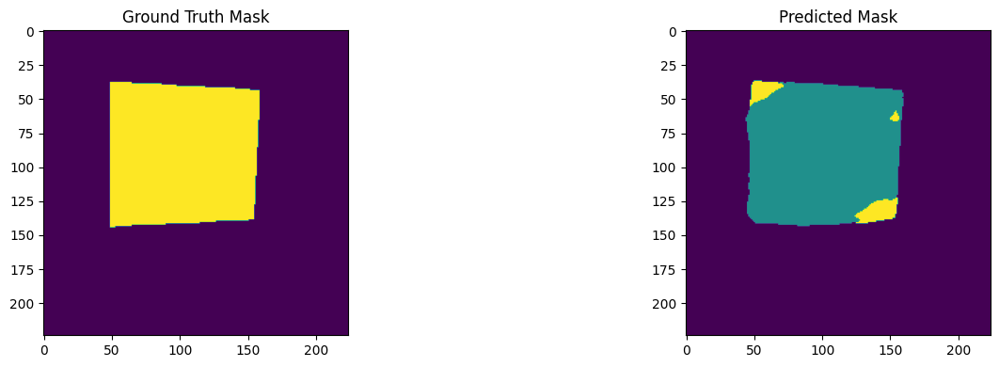

178/178 - 88s - loss: 0.0792 - accuracy: 0.9720 - mean_iou: 0.8417 - val_loss: 0.4944 - val_accuracy: 0.9100 - val_mean_iou: 0.5344 - lr: 0.0010 - 88s/epoch - 495ms/step
Epoch 31/40


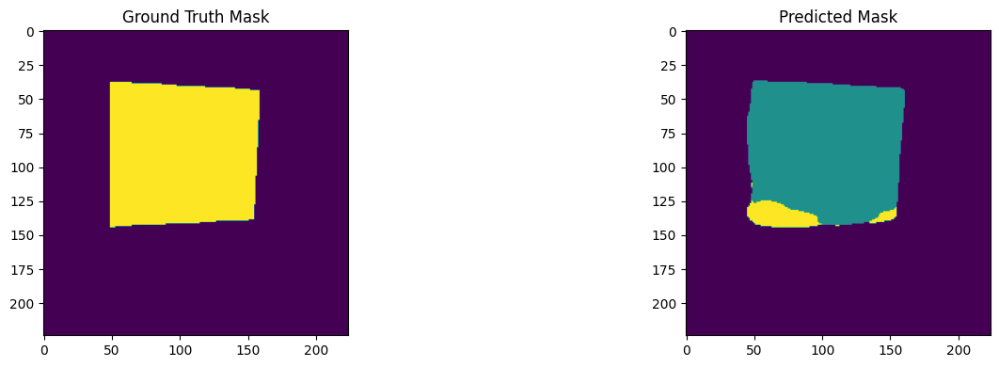

178/178 - 88s - loss: 0.0787 - accuracy: 0.9721 - mean_iou: 0.8406 - val_loss: 0.4466 - val_accuracy: 0.8820 - val_mean_iou: 0.5163 - lr: 0.0010 - 88s/epoch - 493ms/step
Epoch 32/40


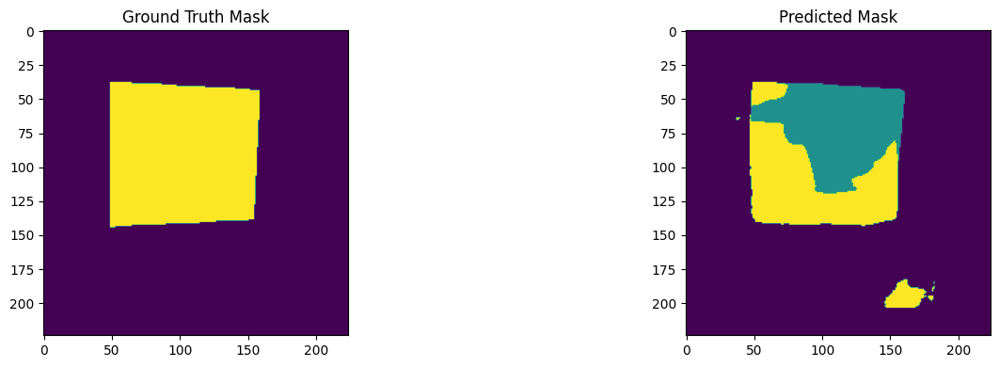

178/178 - 88s - loss: 0.0703 - accuracy: 0.9750 - mean_iou: 0.8565 - val_loss: 0.4320 - val_accuracy: 0.8910 - val_mean_iou: 0.5199 - lr: 0.0010 - 88s/epoch - 494ms/step
Epoch 33/40


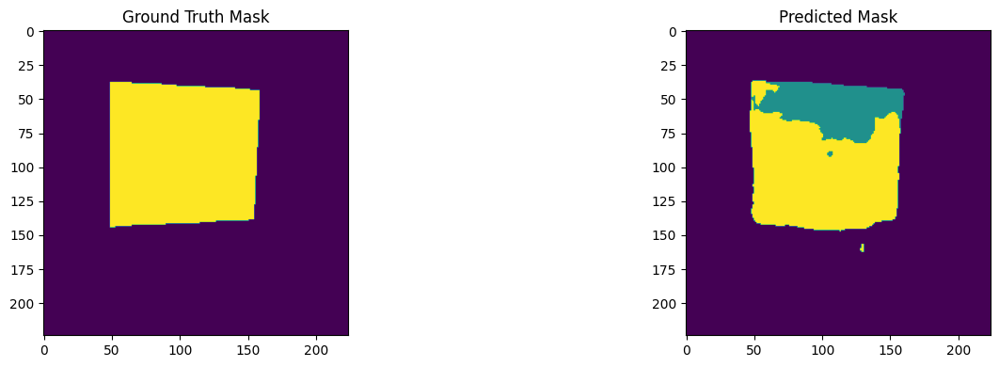

178/178 - 88s - loss: 0.0578 - accuracy: 0.9792 - mean_iou: 0.8815 - val_loss: 0.4748 - val_accuracy: 0.9021 - val_mean_iou: 0.5172 - lr: 0.0010 - 88s/epoch - 493ms/step
Epoch 34/40


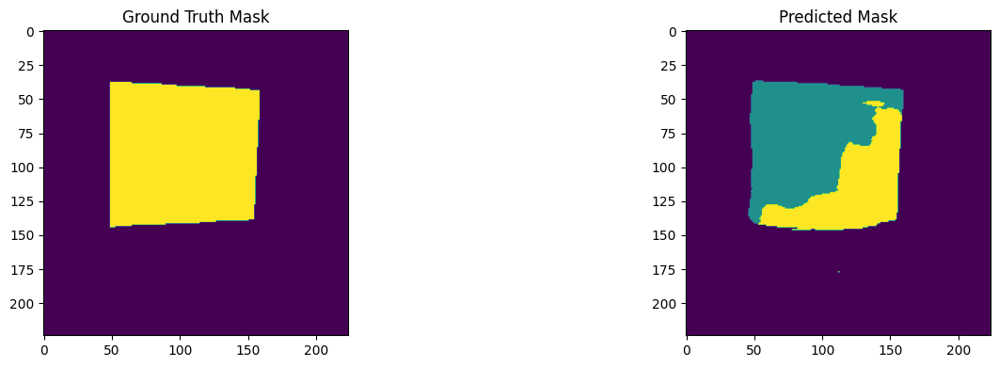

178/178 - 88s - loss: 0.0532 - accuracy: 0.9808 - mean_iou: 0.8919 - val_loss: 0.4438 - val_accuracy: 0.9090 - val_mean_iou: 0.5482 - lr: 0.0010 - 88s/epoch - 493ms/step
Epoch 35/40


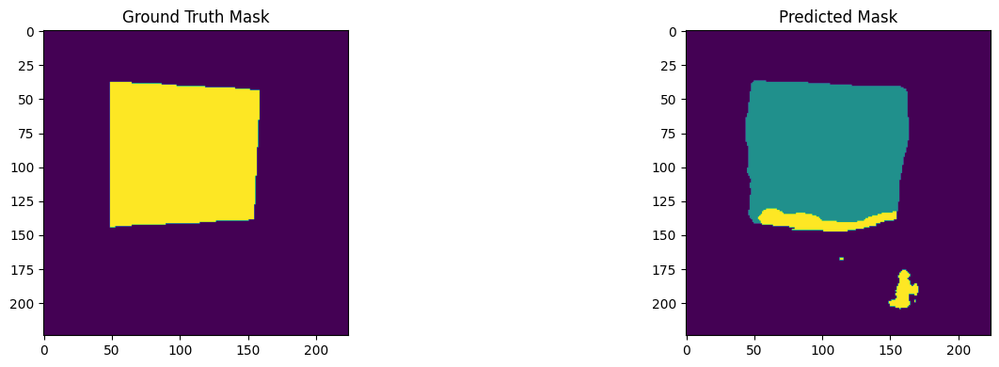

178/178 - 87s - loss: 0.0582 - accuracy: 0.9789 - mean_iou: 0.8797 - val_loss: 0.4651 - val_accuracy: 0.9010 - val_mean_iou: 0.5451 - lr: 0.0010 - 87s/epoch - 491ms/step
Epoch 36/40


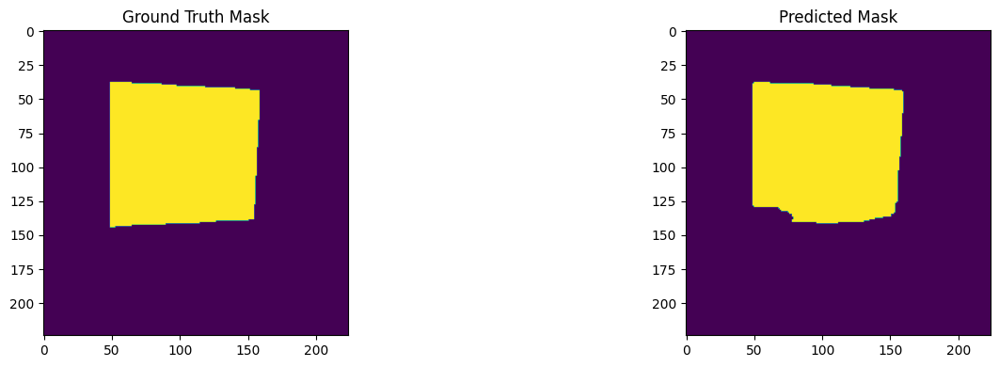

178/178 - 87s - loss: 0.0536 - accuracy: 0.9805 - mean_iou: 0.8887 - val_loss: 0.4688 - val_accuracy: 0.9083 - val_mean_iou: 0.5497 - lr: 0.0010 - 87s/epoch - 491ms/step
Epoch 37/40


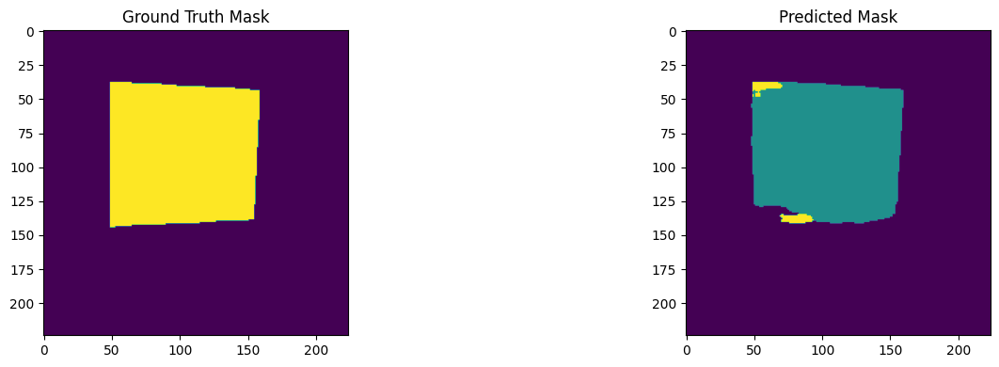

178/178 - 88s - loss: 0.0390 - accuracy: 0.9853 - mean_iou: 0.9178 - val_loss: 0.5689 - val_accuracy: 0.9105 - val_mean_iou: 0.5342 - lr: 0.0010 - 88s/epoch - 492ms/step
Epoch 38/40


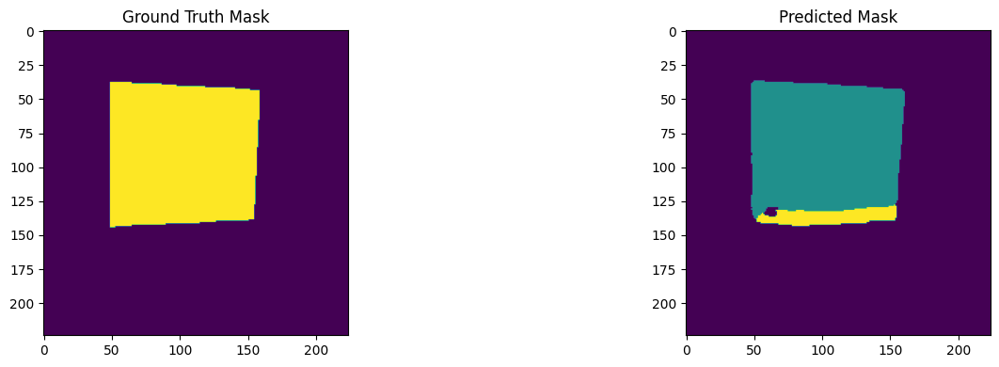

178/178 - 88s - loss: 0.0337 - accuracy: 0.9873 - mean_iou: 0.9282 - val_loss: 0.4733 - val_accuracy: 0.9118 - val_mean_iou: 0.5646 - lr: 0.0010 - 88s/epoch - 493ms/step
Epoch 39/40


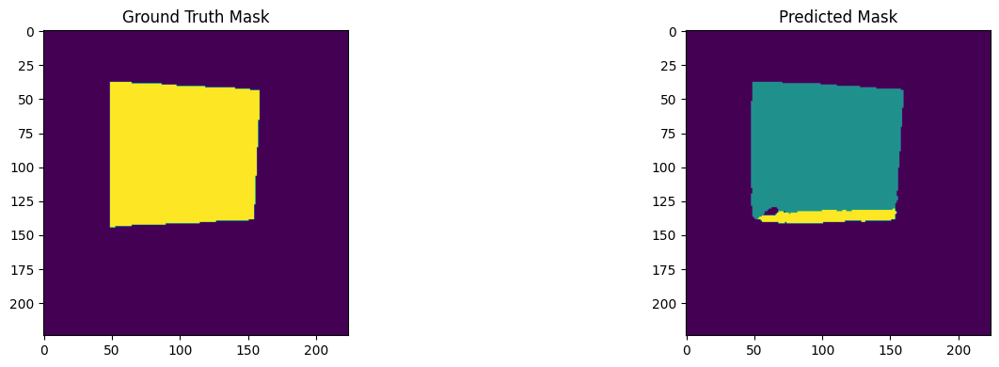

178/178 - 87s - loss: 0.0325 - accuracy: 0.9877 - mean_iou: 0.9308 - val_loss: 0.5502 - val_accuracy: 0.9111 - val_mean_iou: 0.5624 - lr: 0.0010 - 87s/epoch - 489ms/step
Epoch 40/40


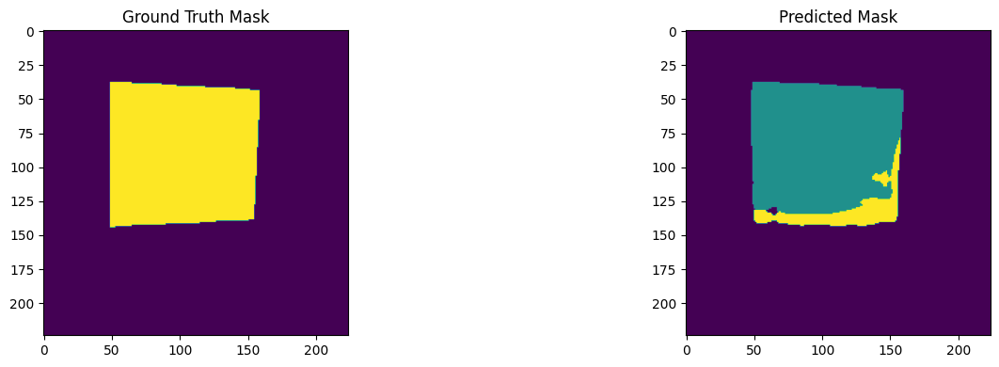

178/178 - 87s - loss: 0.0294 - accuracy: 0.9887 - mean_iou: 0.9363 - val_loss: 0.5404 - val_accuracy: 0.9138 - val_mean_iou: 0.5652 - lr: 0.0010 - 87s/epoch - 491ms/step


In [ ]:
history = model.fit(
    x=train_np,
    y=train_mask_np2,
    epochs = epochs,
    batch_size = batch_size,
    validation_data = (val_np, val_mask_np2),
    callbacks=[early_stopping, viz_callback, scheduler],
    verbose=2
    )

In [ ]:
# Exclude custom classes for saving the model
# model.compile(
#     loss = losses.SparseCategoricalCrossentropy(),
#     optimizer = AdamW(learning_rate),
#     metrics = ["accuracy"]
#     )

# Save the model
# os.makedirs('coco_tv_laptop/models/', exist_ok=True)
# model.save('coco_tv_laptop/models/UNet.keras')

In [ ]:
unet = models.load_model('coco_tv_laptop/models/UNet.keras')

In [ ]:
mask_pred_logits = unet.predict(test_np[index].reshape(1, 224, 224, 3))
print(mask_pred_logits.shape)

1/1 [==============================] - 0s 19ms/step
(1, 224, 224, 3)


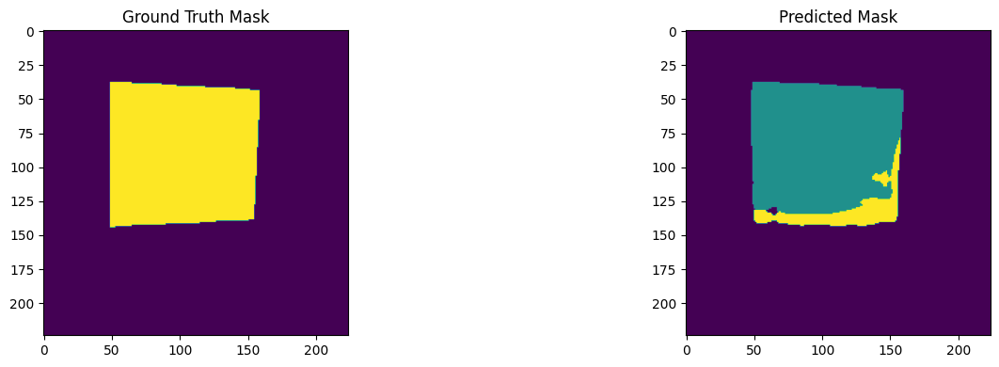

In [ ]:
# Visualize the prediction
y_pred = tf.math.argmax(mask_pred_logits, axis=-1)
y_pred = np.array(y_pred)
y_pred = np.reshape(y_pred, (224, 224, 1))
fig, axes = plt.subplots(1, 2, figsize=(16, 4))
axes[0].imshow(np.squeeze(test_mask_np[index].reshape(224, 224, 1)))
axes[0].set_title("Ground Truth Mask")
axes[1].imshow(np.squeeze(y_pred))
axes[1].set_title("Predicted Mask")
plt.tight_layout()
plt.show()

Everything seems alright!
Let's define a function for blurring and explore the results.

1/1 [==============================] - 2s 2s/step


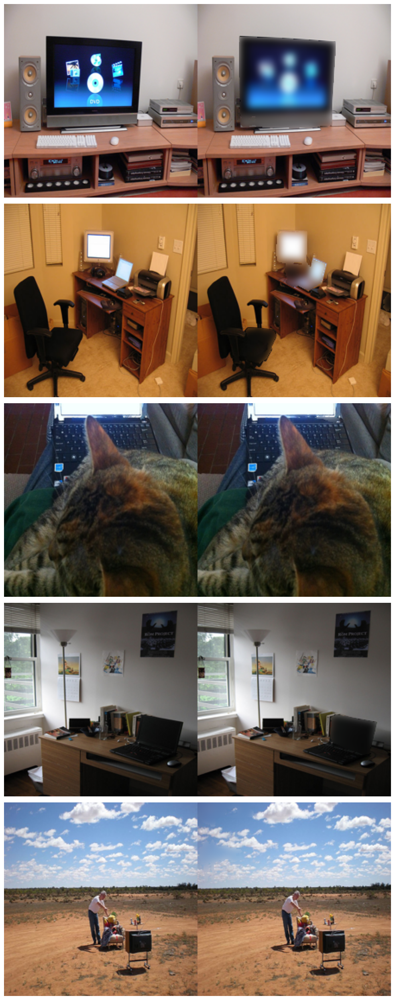

In [ ]:
# Filter function
def apply_filter(image, mask, filter_func):
    filtered_image = filter_func(image)
    return np.where(mask[:, :, None], filtered_image, image)

# Example filter function: Gaussian blur
def gaussian_blur(image):
    return cv2.GaussianBlur(image, (25, 25), 0)

# Plotting function
def plot_images_with_filter(gt_images, predictions, filter_func):
    num_images = len(gt_images)

    # Set up the plot with one image per row
    fig, axes = plt.subplots(num_images, 1, figsize=(10, num_images * 5))

    for i in range(num_images):
        ax = axes[i]

        # Apply filter to the ground truth image
        filtered_image = apply_filter(gt_images[i], predictions[i, :, :], filter_func)
        # Plot the original and filtered images side by side
        ax.imshow(np.hstack([gt_images[i], filtered_image]), cmap='gray')
        ax.axis('off')

    # Adjust layout for better spacing
    plt.tight_layout()
    plt.show()

gt_images = test_np[index:index+5]
predictions_logits = unet.predict(gt_images)
predictions = np.argmax(predictions_logits, axis=-1)

plot_images_with_filter(gt_images, predictions, gaussian_blur)

Sweet!

# Downloading full data (do not execute)



In [ ]:
%cd '/content'

/content


## Define function to make category ids homogeneous across the three datasets

In [ ]:
import json
import os

def modify_annotations(directory, conversion_dict, remove_categories):
    for filename in os.listdir(directory):
        if filename.endswith('.json'):
            filepath = os.path.join(directory, filename)
            with open(filepath, 'r') as file:
                annotations = json.load(file)

            # Update annotations
            updated_annotations = []
            for anno in annotations:
                if anno['category_id'] not in remove_categories:
                    new_category_id = conversion_dict.get(anno['category_id'], (anno['category_id'],))[0]
                    anno['category_id'] = new_category_id
                    updated_annotations.append(anno)

            # Save modified annotations
            with open(filepath, 'w') as file:
                json.dump(updated_annotations, file)

## Import first whiteboard dataset

In [ ]:
!pip install -q roboflow

ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
lida 0.0.10 requires fastapi, which is not installed.
lida 0.0.10 requires kaleido, which is not installed.
lida 0.0.10 requires python-multipart, which is not installed.
lida 0.0.10 requires uvicorn, which is not installed.


In [ ]:
from roboflow import Roboflow

rf = Roboflow(api_key="6dxTdEDOv5SYGgneximm")
project = rf.workspace("sabi-assignment").project("whiteboards")
dataset = project.version(16).download("coco")

loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to Whiteboards-16 in coco:: 100%|██████████| 404/404 [00:00<00:00, 1462.44it/s]


For the validation set:

In [ ]:
import os
import json
import shutil

# Create target directories
os.makedirs('Whiteboards-16-val/images/', exist_ok=True)
os.makedirs('Whiteboards-16-val/annotations/', exist_ok=True)

# Move images
source_images_dir = 'Whiteboards-16/valid/' # 'Whiteboards-16/valid/'
target_images_dir = 'Whiteboards-16-val/images/' # 'Whiteboards-16-val/images/'

# Read the unique JSON file
annotation_path = 'Whiteboards-16/valid/_annotations.coco.json' # 'Whiteboards-16/valid/_annotations.coco.json'  # Corrected the path
with open(annotation_path, 'r') as file:
    data = json.load(file)

# Split annotations for each image
image_annotations = {image['id']: [] for image in data['images']}
for annotation in data['annotations']:
    image_annotations[annotation['image_id']].append(annotation)

# Filter and process images based on annotation categories
for image in data['images']:
    image_id = image['id']
    image_file_name = image['file_name']
    annotations = image_annotations[image_id]

    # Check if the image has annotations of category 0 or 1, but not only category 2
    has_category_1_or_2 = any(anno['category_id'] in [0, 1] for anno in annotations)
    has_only_category_3 = all(anno['category_id'] == 2 for anno in annotations)

    if has_category_1_or_2 and not has_only_category_3:
        # Move the image file
        shutil.move(os.path.join(source_images_dir, image_file_name), os.path.join(target_images_dir, image_file_name))

        # Create a new JSON file for each image's annotations
        new_annotation_file = os.path.join('Whiteboards-16-val/annotations/', image_file_name.replace('.jpg', '.json'))
        with open(new_annotation_file, 'w') as f:
            json.dump(annotations, f)

In [ ]:
# For Whiteboards-16-val
conversion_dict_2 = {1: (2,),0:(2,)}
remove_categories_2 = [2]
modify_annotations('Whiteboards-16-val/annotations', conversion_dict_2, remove_categories_2)

For the train set:

In [ ]:
# Create target directories
os.makedirs('Whiteboards-16-train/images/', exist_ok=True)
os.makedirs('Whiteboards-16-train/annotations/', exist_ok=True)

# Move images
source_images_dir = 'Whiteboards-16/train/' # 'Whiteboards-16/valid/'
target_images_dir = 'Whiteboards-16-train/images/' # 'Whiteboards-16-val/images/'

# Read the unique JSON file
annotation_path = 'Whiteboards-16/train/_annotations.coco.json' # 'Whiteboards-16/valid/_annotations.coco.json'  # Corrected the path
with open(annotation_path, 'r') as file:
    data = json.load(file)

# Split annotations for each image
image_annotations = {image['id']: [] for image in data['images']}
for annotation in data['annotations']:
    image_annotations[annotation['image_id']].append(annotation)

# Filter and process images based on annotation categories
for image in data['images']:
    image_id = image['id']
    image_file_name = image['file_name']
    annotations = image_annotations[image_id]

    # Check if the image has annotations of category 0 or 1, but not only category 2
    has_category_1_or_2 = any(anno['category_id'] in [0, 1] for anno in annotations)
    has_only_category_3 = all(anno['category_id'] == 2 for anno in annotations)

    if has_category_1_or_2 and not has_only_category_3:
        # Move the image file
        shutil.move(os.path.join(source_images_dir, image_file_name), os.path.join(target_images_dir, image_file_name))

        # Create a new JSON file for each image's annotations
        new_annotation_file = os.path.join('Whiteboards-16-train/annotations/', image_file_name.replace('.jpg', '.json'))
        with open(new_annotation_file, 'w') as f:
            json.dump(annotations, f)

In [ ]:
# For Whiteboards-16-train
conversion_dict_2 = {1: (2,),0:(2,)}
remove_categories_2 = [2]
modify_annotations('Whiteboards-16-train/annotations', conversion_dict_2, remove_categories_2)

For the test set:

In [ ]:
# Create target directories
os.makedirs('Whiteboards-16-test/images/', exist_ok=True)
os.makedirs('Whiteboards-16-test/annotations/', exist_ok=True)

# Move images
source_images_dir = 'Whiteboards-16/test/' # 'Whiteboards-16/valid/'
target_images_dir = 'Whiteboards-16-test/images/' # 'Whiteboards-16-val/images/'

# Read the unique JSON file
annotation_path = 'Whiteboards-16/test/_annotations.coco.json' # 'Whiteboards-16/valid/_annotations.coco.json'  # Corrected the path
with open(annotation_path, 'r') as file:
    data = json.load(file)

# Split annotations for each image
image_annotations = {image['id']: [] for image in data['images']}
for annotation in data['annotations']:
    image_annotations[annotation['image_id']].append(annotation)

# Filter and process images based on annotation categories
for image in data['images']:
    image_id = image['id']
    image_file_name = image['file_name']
    annotations = image_annotations[image_id]

    # Check if the image has annotations of category 0 or 1, but not only category 2
    has_category_1_or_2 = any(anno['category_id'] in [0, 1] for anno in annotations)
    has_only_category_3 = all(anno['category_id'] == 2 for anno in annotations)

    if has_category_1_or_2 and not has_only_category_3:
        # Move the image file
        shutil.move(os.path.join(source_images_dir, image_file_name), os.path.join(target_images_dir, image_file_name))

        # Create a new JSON file for each image's annotations
        new_annotation_file = os.path.join('Whiteboards-16-test/annotations/', image_file_name.replace('.jpg', '.json'))
        with open(new_annotation_file, 'w') as f:
            json.dump(annotations, f)

In [ ]:
# For Whiteboards-16-test
conversion_dict_2 = {1: (2,), 0:(2,)}
remove_categories_2 = [2]
modify_annotations('Whiteboards-16-test/annotations', conversion_dict_2, remove_categories_2)

## Import second whiteboard dataset

In [ ]:
project2 = rf.workspace("biit").project("whiteboard-detection")
dataset2 = project2.version(1).download("coco")

loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to WhiteBoard-Detection-1 in coco:: 100%|██████████| 1020/1020 [00:00<00:00, 1582.80it/s]


For the validation set:

In [ ]:
# Create target directories
os.makedirs('WhiteBoard-Detection-1-val/images/', exist_ok=True)
os.makedirs('WhiteBoard-Detection-1-val/annotations/', exist_ok=True)

# Move images
source_images_dir = 'WhiteBoard-Detection-1/valid/' # 'WhiteBoard-Detection-1/valid/'
target_images_dir = 'WhiteBoard-Detection-1-val/images/' # 'WhiteBoard-Detection-1-val/images/'

# Read the unique JSON file
annotation_path = 'WhiteBoard-Detection-1/valid/_annotations.coco.json' # 'WhiteBoard-Detection-1/valid/_annotations.coco.json'  # Corrected the path
with open(annotation_path, 'r') as file:
    data = json.load(file)

# Split annotations for each image
image_annotations = {image['id']: [] for image in data['images']}
for annotation in data['annotations']:
    image_annotations[annotation['image_id']].append(annotation)

# Filter and process images based on annotation categories
for image in data['images']:
    image_id = image['id']
    image_file_name = image['file_name']
    annotations = image_annotations[image_id]

    # Check if the image has annotations of category 1 or 2, but not only category 3
    has_category_1_or_2 = any(anno['category_id'] in [1, 2] for anno in annotations)
    has_only_category_3 = all(anno['category_id'] == 3 for anno in annotations)

    if has_category_1_or_2 and not has_only_category_3:
        # Move the image file
        shutil.move(os.path.join(source_images_dir, image_file_name), os.path.join(target_images_dir, image_file_name))

        # Create a new JSON file for each image's annotations
        new_annotation_file = os.path.join('WhiteBoard-Detection-1-val/annotations/', image_file_name.replace('.jpg', '.json'))
        with open(new_annotation_file, 'w') as f:
            json.dump(annotations, f)


In [ ]:
# For WhiteBoard-Detection-1-val
conversion_dict_1 = {2: (2,), 1: (2,), 0:(2,)}
remove_categories_1 = [3]
modify_annotations('WhiteBoard-Detection-1-val/annotations', conversion_dict_1, remove_categories_1)

For the train set:

In [ ]:
# Create target directories
os.makedirs('WhiteBoard-Detection-1-train/images/', exist_ok=True)
os.makedirs('WhiteBoard-Detection-1-train/annotations/', exist_ok=True)

# Move images
source_images_dir = 'WhiteBoard-Detection-1/train/' # 'WhiteBoard-Detection-1/valid/'
target_images_dir = 'WhiteBoard-Detection-1-train/images/' # 'WhiteBoard-Detection-1-val/images/'

# Read the unique JSON file
annotation_path = 'WhiteBoard-Detection-1/train/_annotations.coco.json' # 'WhiteBoard-Detection-1/valid/_annotations.coco.json'  # Corrected the path
with open(annotation_path, 'r') as file:
    data = json.load(file)

# Split annotations for each image
image_annotations = {image['id']: [] for image in data['images']}
for annotation in data['annotations']:
    image_annotations[annotation['image_id']].append(annotation)

# Filter and process images based on annotation categories
for image in data['images']:
    image_id = image['id']
    image_file_name = image['file_name']
    annotations = image_annotations[image_id]

    # Check if the image has annotations of category 1 or 2, but not only category 3
    has_category_1_or_2 = any(anno['category_id'] in [1, 2] for anno in annotations)
    has_only_category_3 = all(anno['category_id'] == 3 for anno in annotations)

    if has_category_1_or_2 and not has_only_category_3:
        # Move the image file
        shutil.move(os.path.join(source_images_dir, image_file_name), os.path.join(target_images_dir, image_file_name))

        # Create a new JSON file for each image's annotations
        new_annotation_file = os.path.join('WhiteBoard-Detection-1-train/annotations/', image_file_name.replace('.jpg', '.json'))
        with open(new_annotation_file, 'w') as f:
            json.dump(annotations, f)


In [ ]:
# For WhiteBoard-Detection-1-val
conversion_dict_1 = {2: (2,), 1: (2,), 0:(2,)}
remove_categories_1 = [3]
modify_annotations('WhiteBoard-Detection-1-train/annotations', conversion_dict_1, remove_categories_1)

For the test set:

In [ ]:
# Create target directories
os.makedirs('WhiteBoard-Detection-1-test/images/', exist_ok=True)
os.makedirs('WhiteBoard-Detection-1-test/annotations/', exist_ok=True)

# Move images
source_images_dir = 'WhiteBoard-Detection-1/test/' # 'WhiteBoard-Detection-1/valid/'
target_images_dir = 'WhiteBoard-Detection-1-test/images/' # 'WhiteBoard-Detection-1-val/images/'

# Read the unique JSON file
annotation_path = 'WhiteBoard-Detection-1/test/_annotations.coco.json' # 'WhiteBoard-Detection-1/valid/_annotations.coco.json'  # Corrected the path
with open(annotation_path, 'r') as file:
    data = json.load(file)

# Split annotations for each image
image_annotations = {image['id']: [] for image in data['images']}
for annotation in data['annotations']:
    image_annotations[annotation['image_id']].append(annotation)

# Filter and process images based on annotation categories
for image in data['images']:
    image_id = image['id']
    image_file_name = image['file_name']
    annotations = image_annotations[image_id]

    # Check if the image has annotations of category 1 or 2, but not only category 3
    has_category_1_or_2 = any(anno['category_id'] in [1, 2] for anno in annotations)
    has_only_category_3 = all(anno['category_id'] == 3 for anno in annotations)

    if has_category_1_or_2 and not has_only_category_3:
        # Move the image file
        shutil.move(os.path.join(source_images_dir, image_file_name), os.path.join(target_images_dir, image_file_name))

        # Create a new JSON file for each image's annotations
        new_annotation_file = os.path.join('WhiteBoard-Detection-1-test/annotations/', image_file_name.replace('.jpg', '.json'))
        with open(new_annotation_file, 'w') as f:
            json.dump(annotations, f)


In [ ]:
# For WhiteBoard-Detection-1-val
conversion_dict_1 = {2: (2,), 1: (2,), 0:(2,)}
remove_categories_1 = [3]
modify_annotations('WhiteBoard-Detection-1-test/annotations', conversion_dict_1, remove_categories_1)

## Add masks to the whiteboard datasets

In [ ]:
import json
import os

def bbox_to_segmentation(bbox):
    # Convert a bounding box [x, y, width, height] to COCO polygon format
    x, y, width, height = bbox
    return [x, y, x + width, y, x + width, y + height, x, y + height]

def add_segmentation_to_annotations(directory):
    for filename in os.listdir(directory):
        if not filename.endswith('.json'):
            continue

        filepath = os.path.join(directory, filename)
        with open(filepath, 'r') as file:
            annotations = json.load(file)

        for annotation in annotations:
            if 'segmentation' not in annotation or not annotation['segmentation']:
                bbox = annotation['bbox']
                annotation['segmentation'] = [bbox_to_segmentation(bbox)]

        with open(filepath, 'w') as file:
            json.dump(annotations, file)

# Specify the directories of your datasets
annotation_dirs = ['WhiteBoard-Detection-1-val/annotations', 'WhiteBoard-Detection-1-train/annotations', 'WhiteBoard-Detection-1-test/annotations/',
                   'Whiteboards-16-val/annotations', 'Whiteboards-16-train/annotations', 'Whiteboards-16-test/annotations']

for ann_dir in annotation_dirs:
    add_segmentation_to_annotations(ann_dir)


## Create the flipped images of the boards with their respective flipped annotations

In [ ]:
def flip_image(image_path, save_path):
    image = Image.open(image_path)
    flipped_image = image.transpose(Image.FLIP_LEFT_RIGHT)
    flipped_image.save(save_path)

def flip_annotation(annotation_path, image_width, save_path):
    with open(annotation_path, 'r') as file:
        annotations = json.load(file)

        for annotation in annotations:
            # Flip bounding box
            bbox = annotation['bbox']
            x, y, width, height = bbox
            bbox[0] = image_width - x - width  # Update x-coordinate of bbox

            # Flip segmentation masks
            if 'segmentation' in annotation:
                for i, segment in enumerate(annotation['segmentation']):
                    flipped_segment = []
                    for j in range(0, len(segment), 2):  # Iterate through points in pairs
                        x, y = segment[j], segment[j+1]
                        flipped_x = image_width - x  # Flip x-coordinate
                        flipped_segment.extend([flipped_x, y])
                    annotation['segmentation'][i] = flipped_segment

        with open(save_path, 'w') as outfile:
            json.dump(annotations, outfile)


In [ ]:
annotation_dirs = ['WhiteBoard-Detection-1-val/annotations', 'WhiteBoard-Detection-1-train/annotations', 'WhiteBoard-Detection-1-test/annotations/',
                   'Whiteboards-16-val/annotations', 'Whiteboards-16-train/annotations', 'Whiteboards-16-test/annotations']


for ann_dir in annotation_dirs:
    images_dir = ann_dir.replace('annotations','images')
    for filename in os.listdir(images_dir):
        if filename.endswith('.jpg') or filename.endswith('.png'):
            image_path = os.path.join(images_dir, filename)
            annotation_path = os.path.join(ann_dir, os.path.splitext(filename)[0] + '.json')

            flipped_image_path = os.path.join(images_dir, 'flipped_' + filename)
            flipped_annotation_path = os.path.join(ann_dir, 'flipped_' + os.path.splitext(filename)[0] + '.json')

            image = Image.open(image_path)
            image_width, image_height = image.size

            flip_image(image_path, flipped_image_path)
            flip_annotation(annotation_path, image_width, flipped_annotation_path)


## Import COCO dataset for tv and laptops

In [ ]:
# Instantiate COCO specifying the annotations json path
coco = COCO('instances/instances_train2017.json')

# Specify a list of category names of interest
catIds_tv = coco.getCatIds(catNms=['tv'])
catIds_laptop = coco.getCatIds(catNms=['laptop'])

# Get the corresponding image ids and images using loadImgs
imgIds_tv = coco.getImgIds(catIds=catIds_tv)
imgIds_laptop = coco.getImgIds(catIds=catIds_laptop)
print(f"Available monitor images in the dataset of reference: {len(imgIds_tv)}")
print(f"Available laptop images in the dataset of reference: {len(imgIds_laptop)}")

loading annotations into memory...
Done (t=22.27s)
creating index...
index created!
Available monitor images in the dataset of reference: 4561
Available laptop images in the dataset of reference: 3524


In [ ]:
# Select 2000 images for each class
imgIds = list(set(imgIds_tv[:2000]).union(set(imgIds_laptop[:2000])))
images = coco.loadImgs(imgIds)
images[0]

{'license': 1,
 'file_name': '000000483328.jpg',
 'coco_url': 'http://images.cocodataset.org/train2017/000000483328.jpg',
 'height': 375,
 'width': 500,
 'date_captured': '2013-11-15 22:38:44',
 'flickr_url': 'http://farm2.staticflickr.com/1027/533762534_75e6af7d59_z.jpg',
 'id': 483328}

In [ ]:
# Filter annotations
annotations = []
for imgId in imgIds:
    ann_ids = coco.getAnnIds(imgIds=imgId, catIds=[72, 73], iscrowd=None)
    annotations.extend(coco.loadAnns(ann_ids))

In [ ]:
import os
import json
import requests
from PIL import Image
from io import BytesIO

# Create directories if they don't exist
os.makedirs('coco_tv_laptop/images/', exist_ok=True)
os.makedirs('coco_tv_laptop/annotations/', exist_ok=True)

# Function to download and save an image
def download_and_save_image(image_info, save_dir):
    response = requests.get(image_info['coco_url'])
    if response.status_code == 200:
        image = Image.open(BytesIO(response.content))
        image.save(os.path.join(save_dir, image_info['file_name']))

# Iterate over images and annotations
for image in images:
    # Download and save image
    download_and_save_image(image, 'coco_tv_laptop/images/')

    # Filter annotations for this image
    image_annotations = [ann for ann in annotations if ann['image_id'] == image['id']]

    # Save annotations to JSON file
    annotation_file = os.path.join('coco_tv_laptop/annotations/', image['file_name'].replace('.jpg', '.json'))
    with open(annotation_file, 'w') as f:
        json.dump(image_annotations, f)


## Merge the three datasets and split

### Step 1: copy all images into one directory

In [ ]:
import shutil
import os

def copy_images(source_dir, target_dir):
    for filename in os.listdir(source_dir):
        if filename.endswith('.jpg') or filename.endswith('.png'):  # Add other image formats if needed
            shutil.copy(os.path.join(source_dir, filename), target_dir)

# Create a directory for all images
os.makedirs('final_dataset/images', exist_ok=True)

# Copy images from each dataset
annotation_dirs = ['WhiteBoard-Detection-1-val/annotations', 'WhiteBoard-Detection-1-train/annotations', 'WhiteBoard-Detection-1-test/annotations/',
                   'Whiteboards-16-val/annotations', 'Whiteboards-16-train/annotations', 'Whiteboards-16-test/annotations', 'coco_tv_laptop/annotations']
for ann_dir in annotation_dirs:
  copy_images(ann_dir.replace('annotations','images'), 'final_dataset/images')


### Step 2: Combine Annotations


Since each image has its own annotation file, you'll need to:

1.   Load each annotation file.
2.   Update the image ID and annotation IDs.
3.   Write out each updated annotation to a new file in the combined annotations directory.
4.   Make sure the image file names are unique across datasets to avoid overwriting.

In [ ]:
import json
import os

# Function to update IDs in annotations
def update_ids(annotations, start_annotation_id):
    for annotation in annotations:
        annotation['id'] = start_annotation_id
        start_annotation_id += 1
    return start_annotation_id

# Initialize IDs
next_annotation_id = 1

# Paths to the annotation directories of the datasets
annotation_dirs = ['WhiteBoard-Detection-1-val/annotations', 'WhiteBoard-Detection-1-train/annotations', 'WhiteBoard-Detection-1-test/annotations/',
                   'Whiteboards-16-val/annotations', 'Whiteboards-16-train/annotations', 'Whiteboards-16-test/annotations', 'coco_tv_laptop/annotations']

# Create a directory for combined annotations
os.makedirs('final_dataset/annotations', exist_ok=True)

# Process each annotation directory
for ann_dir in annotation_dirs:
    for filename in os.listdir(ann_dir):
        if filename.endswith('.json'):
            with open(os.path.join(ann_dir, filename), 'r') as file:
                annotations = json.load(file)

            # Update annotation IDs
            next_annotation_id = update_ids(annotations, next_annotation_id)

            # Write out updated annotation
            with open(f'final_dataset/annotations/{filename}', 'w') as file:
                json.dump(annotations, file)


### Step 3: split the final dataset into train and valid

In [ ]:
import os
import shutil
import random

# Set the seed for reproducibility
random.seed(42)

# Define the source directories
source_images_dir = 'final_dataset/images'
source_annotations_dir = 'final_dataset/annotations'

# Define the destination directories
dest_base_dir = 'final_dataset_splitted'
train_images_dir = os.path.join(dest_base_dir, 'train/images')
train_annotations_dir = os.path.join(dest_base_dir, 'train/annotations')
val_images_dir = os.path.join(dest_base_dir, 'valid/images')
val_annotations_dir = os.path.join(dest_base_dir, 'valid/annotations')

# Create the destination directories
os.makedirs(train_images_dir, exist_ok=True)
os.makedirs(train_annotations_dir, exist_ok=True)
os.makedirs(val_images_dir, exist_ok=True)
os.makedirs(val_annotations_dir, exist_ok=True)

# Get a list of filenames (without extension) from the source annotations directory
filenames = [os.path.splitext(f)[0] for f in os.listdir(source_annotations_dir) if f.endswith('.json')]
random.shuffle(filenames)

# Split ratio (e.g., 80% training, 20% validation)
split_ratio = 0.9
split_index = int(len(filenames) * split_ratio)

# Split filenames into train and val sets
train_filenames = filenames[:split_index]
val_filenames = filenames[split_index:]

# Function to copy files
def copy_files(filenames, source_dir, dest_dir, file_extension):
    for filename in filenames:
        full_filename = f"{filename}{file_extension}"
        shutil.copyfile(os.path.join(source_dir, full_filename), os.path.join(dest_dir, full_filename))

# Copy files to their respective directories
copy_files(train_filenames, source_images_dir, train_images_dir, '.jpg')
copy_files(train_filenames, source_annotations_dir, train_annotations_dir, '.json')
copy_files(val_filenames, source_images_dir, val_images_dir, '.jpg')
copy_files(val_filenames, source_annotations_dir, val_annotations_dir, '.json')


## Save the final_dataset and final_dataset_splitted directories in .zip

In [ ]:
from google.colab import drive
import os
import numpy as np

# Step 1: Mount Google Drive
#drive.mount('/content/drive')

# Step 2: Zip the Directory
# Replace 'your_directory_path' with the path of the directory you want to zip
# Replace 'zipped_file.zip' with the desired name of the zipped file
#!zip -r final_dataset.zip final_dataset
#!zip -r final_dataset_splitted.zip final_dataset_splitted

# Step 3: Save to Google Drive
# Replace 'your_drive_folder_path' with the path of the folder in your Drive where you want to save the file
os.makedirs('/content/drive/MyDrive/DL4CV_skip_connections/final_dataset_zipped', exist_ok=True)

!mv final_dataset.zip '/content/drive/MyDrive/DL4CV_skip_connections/final_dataset_zipped/'
!mv final_dataset_splitted.zip '/content/drive/MyDrive/DL4CV_skip_connections/final_dataset_zipped/'

## Reload the dataset

In [ ]:
%cd '/content/drive/MyDrive/DL4CV_skip_connections'

/content/drive/.shortcut-targets-by-id/1wToTsqcA1xTnuiZHb88Q43OKnaCaZhF0/DL4CV_skip_connections


In [ ]:
### For final_dataset
# Step 1: Copy the Zipped File to Colab
# Replace 'path_to_zip_in_drive' with the path to your zipped file in Google Drive
# Replace 'zipped_file.zip' with the name of your zipped file
!cp 'final_dataset_zipped/final_dataset.zip' 'final_dataset.zip'

# Step 2: Unzip the File
# This will unzip the file in the current directory (/content/)
!unzip 'final_dataset.zip' -d '/content/drive/My Drive/DL4CV_skip_connections/'

### For final_dataset_splitted
# Step 1: Copy the Zipped File to Colab
# Replace 'path_to_zip_in_drive' with the path to your zipped file in Google Drive
# Replace 'zipped_file.zip' with the name of your zipped file
!cp 'final_dataset_zipped/final_dataset_splitted.zip' 'final_dataset_splitted.zip'

# Step 2: Unzip the File
# This will unzip the file in the current directory (/content/)
!unzip 'final_dataset_splitted.zip' -d '/content/drive/My Drive/DL4CV_skip_connections/'


Output streaming troncato alle ultime 5000 righe.
  inflating: /content/drive/My Drive/DL4CV_skip_connections/final_dataset_splitted/train/images/000000549199.jpg  
  inflating: /content/drive/My Drive/DL4CV_skip_connections/final_dataset_splitted/train/images/000000016669.jpg  
  inflating: /content/drive/My Drive/DL4CV_skip_connections/final_dataset_splitted/train/images/000000238502.jpg  
  inflating: /content/drive/My Drive/DL4CV_skip_connections/final_dataset_splitted/train/images/000000215383.jpg  
  inflating: /content/drive/My Drive/DL4CV_skip_connections/final_dataset_splitted/train/images/000000396068.jpg  
  inflating: /content/drive/My Drive/DL4CV_skip_connections/final_dataset_splitted/train/images/000000527497.jpg  
  inflating: /content/drive/My Drive/DL4CV_skip_connections/final_dataset_splitted/train/images/flipped_videoplayback_10_mp4-26_jpg.rf.db4ba66a09d309e99b09496cc5959de5.jpg  
  inflating: /content/drive/My Drive/DL4CV_skip_connections/final_dataset_splitted/tra

# Fine-tuning of Detectron2

Import the final dataset from the zipped file

In [ ]:
### For final_dataset
# Step 1: Copy the Zipped File to Colab
# Replace 'path_to_zip_in_drive' with the path to your zipped file in Google Drive
# Replace 'zipped_file.zip' with the name of your zipped file
!cp 'final_dataset_zipped/final_dataset.zip' 'final_dataset.zip'

# Step 2: Unzip the File
# This will unzip the file in the current directory (/content/)
!unzip 'final_dataset.zip' -d '/content/'

Streaming output truncated to the last 5000 lines.
  inflating: /content/final_dataset/images/000000434898.jpg  
  inflating: /content/final_dataset/images/000000279491.jpg  
  inflating: /content/final_dataset/images/000000060350.jpg  
  inflating: /content/final_dataset/images/000000164366.jpg  
  inflating: /content/final_dataset/images/000000222037.jpg  
  inflating: /content/final_dataset/images/000000549230.jpg  
  inflating: /content/final_dataset/images/videoplayback_11_mp4-15_jpg.rf.278c8908057e8727d54569f9abcb3605.jpg  
  inflating: /content/final_dataset/images/flipped_How-to-Use-the-Whiteboard-Effectively_mp4-19_jpg.rf.fd7048a7551e5c405b59948720c56f8a.jpg  
  inflating: /content/final_dataset/images/000000256465.jpg  
  inflating: /content/final_dataset/images/000000534048.jpg  
  inflating: /content/final_dataset/images/000000527733.jpg  
  inflating: /content/final_dataset/images/000000100812.jpg  
  inflating: /content/final_dataset/images/000000189305.jpg  
  inflating:

In [ ]:
%cd '/content'

/content


In [ ]:
import os
import shutil
import random

# Set the seed for reproducibility
random.seed(42)

# Define the source directories
source_images_dir = 'final_dataset/images'
source_annotations_dir = 'final_dataset/annotations'

# Define the destination directories
dest_base_dir = 'final_dataset_splitted'
train_images_dir = os.path.join(dest_base_dir, 'train/images')
train_annotations_dir = os.path.join(dest_base_dir, 'train/annotations')
val_images_dir = os.path.join(dest_base_dir, 'valid/images')
val_annotations_dir = os.path.join(dest_base_dir, 'valid/annotations')

# Create the destination directories
os.makedirs(train_images_dir, exist_ok=True)
os.makedirs(train_annotations_dir, exist_ok=True)
os.makedirs(val_images_dir, exist_ok=True)
os.makedirs(val_annotations_dir, exist_ok=True)

# Get a list of filenames (without extension) from the source annotations directory
filenames = [os.path.splitext(f)[0] for f in os.listdir(source_annotations_dir) if f.endswith('.json')]
random.shuffle(filenames)

# Split ratio (e.g., 80% training, 20% validation)
split_ratio = 0.9
split_index = int(len(filenames) * split_ratio)

# Split filenames into train and val sets
train_filenames = filenames[:split_index]
val_filenames = filenames[split_index:]

# Function to copy files
def copy_files(filenames, source_dir, dest_dir, file_extension):
    for filename in filenames:
        full_filename = f"{filename}{file_extension}"
        shutil.copyfile(os.path.join(source_dir, full_filename), os.path.join(dest_dir, full_filename))

# Copy files to their respective directories
copy_files(train_filenames, source_images_dir, train_images_dir, '.jpg')
copy_files(train_filenames, source_annotations_dir, train_annotations_dir, '.json')
copy_files(val_filenames, source_images_dir, val_images_dir, '.jpg')
copy_files(val_filenames, source_annotations_dir, val_annotations_dir, '.json')

## Install detectron2

In [ ]:
!python -m pip install -q pyyaml==5.1
import sys, os, distutils.core
# Note: This is a faster way to install detectron2 in Colab, but it does not include all functionalities (e.g. compiled operators).
# See https://detectron2.readthedocs.io/tutorials/install.html for full installation instructions
!git clone 'https://github.com/facebookresearch/detectron2'
dist = distutils.core.run_setup("./detectron2/setup.py")
!python -m pip install -q {' '.join([f"'{x}'" for x in dist.install_requires])}
sys.path.insert(0, os.path.abspath('./detectron2'))

# Properly install detectron2. (Please do not install twice in both ways)
# !python -m pip install 'git+https://github.com/facebookresearch/detectron2.git'

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 274.2/274.2 kB 3.0 MB/s eta 0:00:00
  error: subprocess-exited-with-error
  
  × python setup.py egg_info did not run successfully.
  │ exit code: 1
  ╰─> See above for output.
  
  note: This error originates from a subprocess, and is likely not a problem with pip.
  Preparing metadata (setup.py) ... error
error: metadata-generation-failed

× Encountered error while generating package metadata.
╰─> See above for output.

note: This is an issue with the package mentioned above, not pip.
hint: See above for details.
Cloning into 'detectron2'...
remote: Enumerating objects: 15292, done.
remote: Counting objects: 100% (17/17), done.
remote: Compressing objects: 100% (16/16), done.
remote: Total 15292 (delta 3), reused 6 (delta 1), pack-reused 15275
Receiving objects: 100% (15292/15292), 6.18 MiB | 14.29 MiB/s, done.
Resolving deltas: 100% (11118/11118), done.
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 50.2/50.2 kB 1.7 MB/s eta 0:00:00
  Pre

In [ ]:
import torch, detectron2
!nvcc --version
TORCH_VERSION = ".".join(torch.__version__.split(".")[:2])
CUDA_VERSION = torch.__version__.split("+")[-1]
print("torch: ", TORCH_VERSION, "; cuda: ", CUDA_VERSION)
print("detectron2:", detectron2.__version__)

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2022 NVIDIA Corporation
Built on Wed_Sep_21_10:33:58_PDT_2022
Cuda compilation tools, release 11.8, V11.8.89
Build cuda_11.8.r11.8/compiler.31833905_0
torch:  2.1 ; cuda:  cu118
detectron2: 0.6


In [ ]:
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

## Load final_dataset to detectron2

In [ ]:
def remap_category_id(old_id):
    category_mapping = {2: 0, 72: 1, 73: 2} # {1: 0, 2: 1, 72: 2, 73: 3}
    return category_mapping.get(old_id, old_id)

### Get detectron dataset for mask r-cnn

In [ ]:
DatasetCatalog.clear()

In [ ]:
import os
import json
import cv2
from detectron2.structures import BoxMode

def get_detectron_dataset(directory):
    dataset_dicts = []
    for filename in os.listdir(directory):
        if filename.endswith(".json"):
            json_file = os.path.join(directory, filename)
            with open(json_file) as f:
                img_anns = json.load(f)

            record = {}
            image_filename = filename.replace('.json', '.jpg')
            image_path = os.path.join('final_dataset/images', image_filename)
            height, width = cv2.imread(image_path).shape[:2]

            record["file_name"] = image_path
            record["image_id"] = filename
            record["height"] = height
            record["width"] = width

            objs = []
            for anno in img_anns:
                # Assuming the bbox is in XYWH_ABS format
                bbox = anno['bbox']
                # Convert bbox to XYXY format
                bbox_xyxy = [bbox[0], bbox[1], bbox[0] + bbox[2], bbox[1] + bbox[3]]

                obj = {
                    "bbox": bbox_xyxy,
                    "bbox_mode": BoxMode.XYXY_ABS,
                    "segmentation": anno['segmentation'],
                    "category_id": remap_category_id(anno['category_id']),
                    "iscrowd": anno.get("iscrowd", 0)
                }
                objs.append(obj)
            record["annotations"] = objs
            dataset_dicts.append(record)
    return dataset_dicts

# Register the dataset
for d in ["train", "valid"]:
    DatasetCatalog.register("final_dataset_" + d, lambda d=d: get_detectron_dataset(f"final_dataset_splitted/{d}/annotations"))
    MetadataCatalog.get("final_dataset_" + d).set(thing_classes =["board", "tv", "laptop"])# =["person", "board", "tv", "laptop"])

dataset_metadata = MetadataCatalog.get("final_dataset_train")

### Let's verify that the dataset is correct

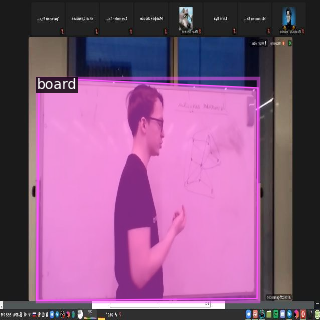

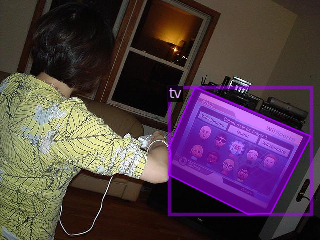

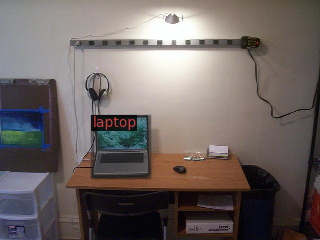

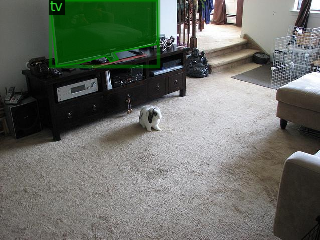

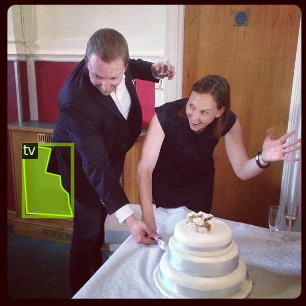

...

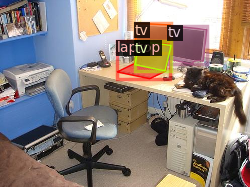

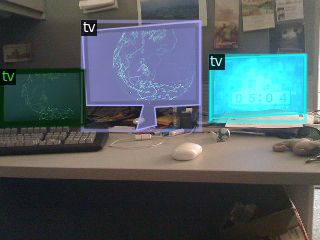

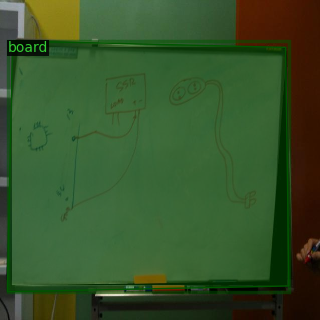

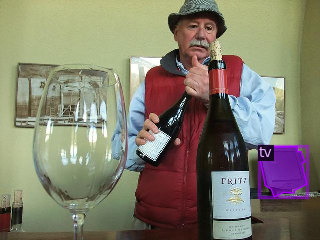

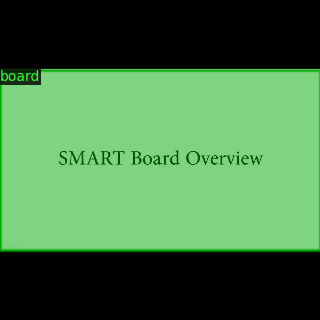

In [ ]:
dataset_dicts = get_detectron_dataset("final_dataset_splitted/valid/annotations")
for d in random.sample(dataset_dicts, 20):
    img = cv2.imread(d["file_name"])
    visualizer = Visualizer(img[:, :, ::-1], metadata=dataset_metadata, scale=0.5)
    out = visualizer.draw_dataset_dict(d)
    cv2_imshow(out.get_image()[:, :, ::-1])

## Let's train the detectron2 mask r-cnn

In [ ]:
from detectron2.engine import DefaultTrainer
from detectron2.structures import BoxMode

cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file('COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml')) #("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.DATASETS.TRAIN = ("final_dataset_train",)
cfg.DATASETS.TEST = ("final_dataset_valid",)
cfg.DATALOADER.NUM_WORKERS = 2
cfg.MODEL.WEIGHTS = model_zoo.get_checkpoint_url('COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml') #("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml")  # Let training initialize from model zoo
cfg.SOLVER.IMS_PER_BATCH = 2  # This is the real "batch size" commonly known to deep learning people
cfg.SOLVER.BASE_LR = 0.00025  # pick a good LR
cfg.SOLVER.MAX_ITER = 1500    # 300 iterations seems good enough for this dataset; you will need to train longer for a practical dataset
cfg.SOLVER.STEPS = []        # do not decay learning rate
cfg.MODEL.ROI_HEADS.BATCH_SIZE_PER_IMAGE = 512   # The "RoIHead batch size". 128 is faster, and good enough for this dataset (default: 512)
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 3
# NOTE: this config means the number of classes, but a few popular unofficial tutorials incorrect uses num_classes+1 here.

os.makedirs(cfg.OUTPUT_DIR, exist_ok=True)
trainer = DefaultTrainer(cfg)
trainer.resume_or_load(resume=False)
trainer.train()

[12/14 17:09:19 d2.engine.defaults]: Model:
GeneralizedRCNN(
  (backbone): FPN(
    (fpn_lateral2): Conv2d(256, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output2): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral3): Conv2d(512, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output3): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral4): Conv2d(1024, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output4): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (fpn_lateral5): Conv2d(2048, 256, kernel_size=(1, 1), stride=(1, 1))
    (fpn_output5): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (top_block): LastLevelMaxPool()
    (bottom_up): ResNet(
      (stem): BasicStem(
        (conv1): Conv2d(
          3, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False
          (norm): FrozenBatchNorm2d(num_features=64, eps=1e-05)
        )
      )
      (res

model_final_f10217.pkl: 178MB [00:01, 119MB/s]                           
roi_heads.box_predictor.bbox_pred.{bias, weight}
roi_heads.box_predictor.cls_score.{bias, weight}
roi_heads.mask_head.predictor.{bias, weight}


[12/14 17:09:39 d2.engine.train_loop]: Starting training from iteration 0
[12/14 17:10:01 d2.utils.events]:  eta: 0:09:16  iter: 19  total_loss: 2.198  loss_cls: 1.343  loss_box_reg: 0.13  loss_mask: 0.6945  loss_rpn_cls: 0.01966  loss_rpn_loc: 0.004899    time: 0.3807  last_time: 0.6369  data_time: 0.0351  last_data_time: 0.0105   lr: 4.9953e-06  max_mem: 2272M
[12/14 17:10:11 d2.utils.events]:  eta: 0:09:32  iter: 39  total_loss: 2.095  loss_cls: 1.256  loss_box_reg: 0.1434  loss_mask: 0.6836  loss_rpn_cls: 0.01469  loss_rpn_loc: 0.004038    time: 0.4378  last_time: 0.2561  data_time: 0.0247  last_data_time: 0.0265   lr: 9.9902e-06  max_mem: 2617M
[12/14 17:10:22 d2.utils.events]:  eta: 0:10:17  iter: 59  total_loss: 1.89  loss_cls: 1.036  loss_box_reg: 0.1657  loss_mask: 0.6641  loss_rpn_cls: 0.02473  loss_rpn_loc: 0.004618    time: 0.4681  last_time: 0.2697  data_time: 0.0401  last_data_time: 0.0043   lr: 1.4985e-05  max_mem: 2617M
[12/14 17:10:26 d2.utils.events]:  eta: 0:07:52  i

In [ ]:
# Look at training curves in tensorboard:
%load_ext tensorboard
%tensorboard --logdir output

<IPython.core.display.Javascript object>

In [ ]:
# Inference should use the config with parameters that are used in training
# cfg now already contains everything we've set previously. We changed it a little bit for inference:
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, "model_final.pth")  # path to the model we just trained
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5   # set a custom testing threshold
predictor = DefaultPredictor(cfg)

[12/14 17:19:42 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from ./output/model_final.pth ...


In [ ]:
# Path to your 'output' directory
model_dir_path = '/content/output'  # Replace with the path to your 'output' directory

# Path in your Google Drive where you want to store the copy
drive_dir_path = '/content/drive/My Drive/DL4CV_skip_connections/trained_detectron2_mask_rcnn'  # Replace with your target path in Google Drive

# Ensure the target directory exists
os.makedirs(drive_dir_path, exist_ok=True)

# Define the final path where the 'output' directory will be copied
final_path = os.path.join(drive_dir_path, 'output')

# Copy the entire 'output' directory
shutil.copytree(model_dir_path, final_path)

'/content/drive/My Drive/DL4CV_skip_connections/trained_detectron2_mask_rcnn/output'

## ReUsing already trained model

In [ ]:
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2 import model_zoo

# Create a configuration identical to the one used for training
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 3  # Make sure to set the number of classes

# Path to the saved weights in Google Drive
cfg.MODEL.WEIGHTS = '/content/drive/My Drive/DL4CV_skip_connections/output/model_final.pth'  # Updated path

# Threshold for predictions
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5

# Create predictor object
predictor = DefaultPredictor(cfg)

[12/14 17:20:04 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/drive/My Drive/DL4CV_skip_connections/output/model_final.pth ...


## Detectron2 Mask r-cnn inference

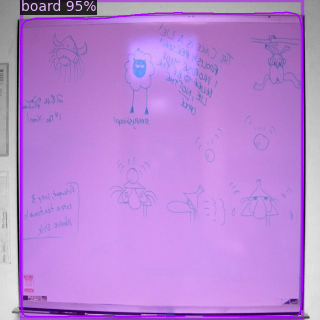

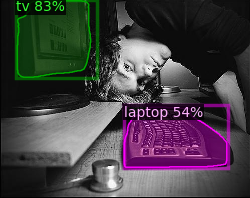

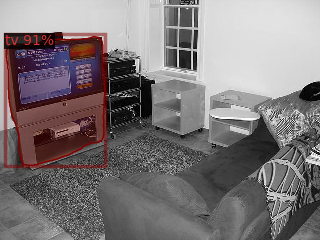

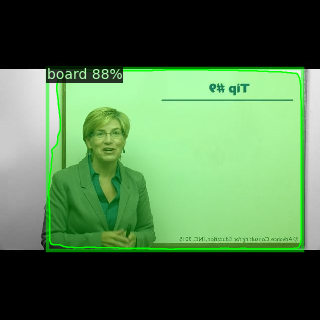

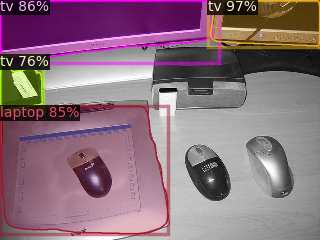

...

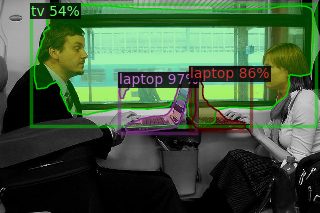

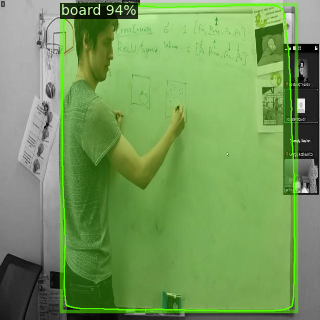

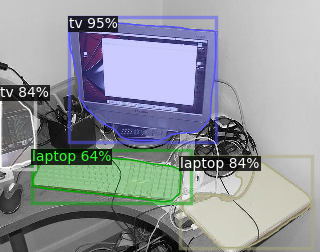

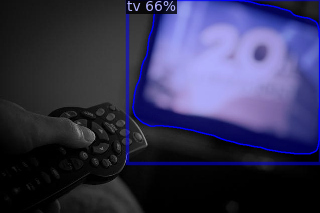

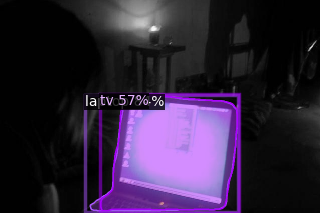

In [ ]:
from detectron2.utils.visualizer import ColorMode
random.seed(42)
dataset_dicts = get_detectron_dataset("final_dataset_splitted/valid/annotations")
for d in random.sample(dataset_dicts, 20):
    im = cv2.imread(d["file_name"])
    outputs = predictor(im)  # format is documented at https://detectron2.readthedocs.io/tutorials/models.html#model-output-format
    v = Visualizer(im[:, :, ::-1],
                   metadata=dataset_metadata,
                   scale=0.5,
                   instance_mode=ColorMode.IMAGE_BW   # remove the colors of unsegmented pixels. This option is only available for segmentation models
    )
    out = v.draw_instance_predictions(outputs["instances"].to("cpu"))
    cv2_imshow(out.get_image()[:, :, ::-1])

In [ ]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = COCOEvaluator("final_dataset_valid", output_dir="./output")
val_loader = build_detection_test_loader(cfg, "final_dataset_valid")
print(inference_on_dataset(predictor.model, val_loader, evaluator))
# another equivalent way to evaluate the model is to use `trainer.test`

We can see an AP50 of ~77.7%, and an AR area= large of ~ 74.5%, a good result for the moment

## Blurring

We can see some examples of blurred images from the validation set:

[12/14 17:22:09 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/drive/My Drive/DL4CV_skip_connections/output/model_final.pth ...


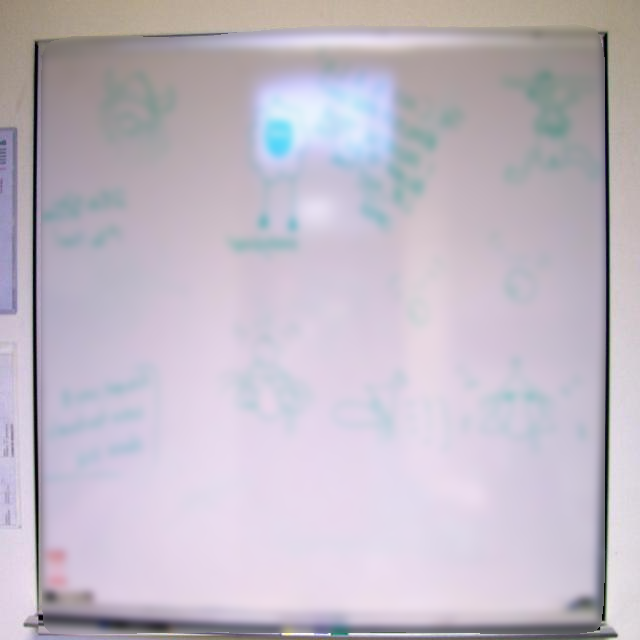

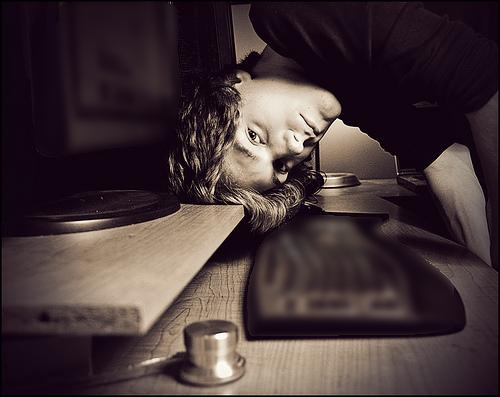

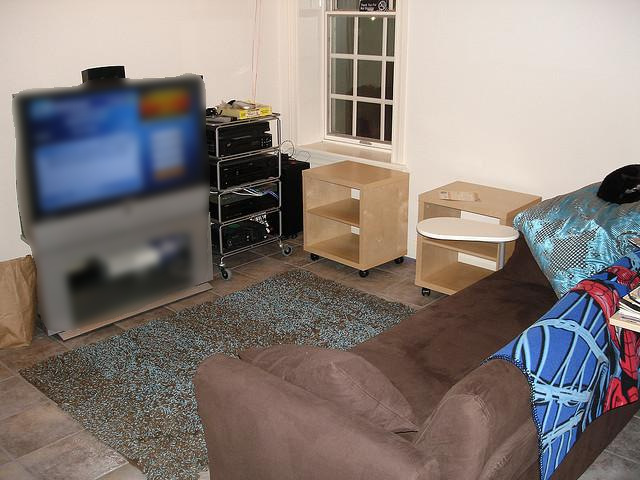

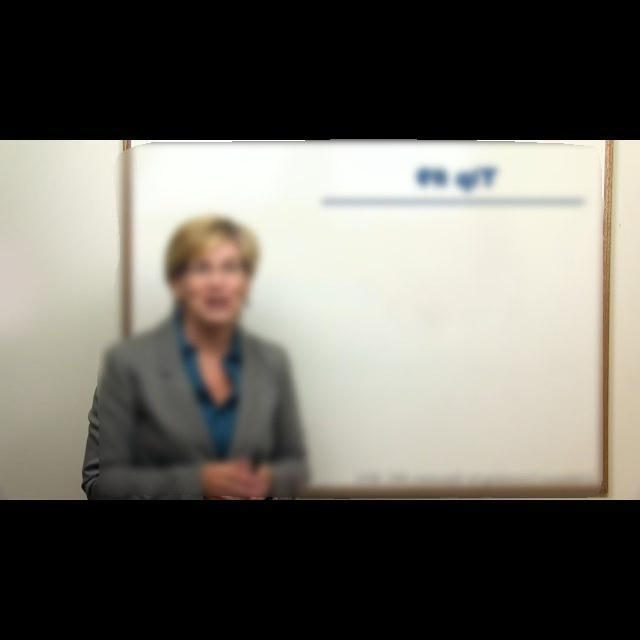

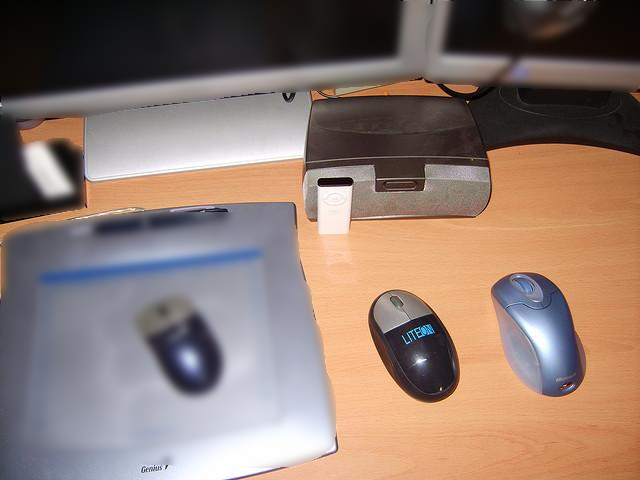

In [ ]:
import torch
import cv2
import numpy as np
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg

# Filter function
def apply_filter(image, mask, filter_func):
    filtered_image = filter_func(image)
    return np.where(mask[:, :, None], filtered_image, image)

# Example filter function: Gaussian blur
def gaussian_blur(image):
    return cv2.GaussianBlur(image, (25, 25), 0)

random.seed(42)

predictor = DefaultPredictor(cfg)
dataset_dicts = get_detectron_dataset("final_dataset_splitted/valid/annotations")
for d in random.sample(dataset_dicts, 5):
    image = cv2.imread(d["file_name"])
    outputs = predictor(image)
    masks = outputs["instances"].pred_masks.to("cpu").numpy()

    for mask in masks:
            image = apply_filter(image, mask, gaussian_blur)

    # Save or display the result
    # cv2.imwrite("filtered_image.jpg", image)
    cv2_imshow(image)

# Final model

In [ ]:
%cd '/content/drive/My Drive/DL4CV_skip_connections'

/content/drive/My Drive/DL4CV_skip_connections


## Install detectron2

In [ ]:
!python -m pip install -q pyyaml==5.1
import sys, os, distutils.core
# Note: This is a faster way to install detectron2 in Colab, but it does not include all functionalities (e.g. compiled operators).
# See https://detectron2.readthedocs.io/tutorials/install.html for full installation instructions
!git clone 'https://github.com/facebookresearch/detectron2'
dist = distutils.core.run_setup("./detectron2/setup.py")
!python -m pip install -q {' '.join([f"'{x}'" for x in dist.install_requires])}
sys.path.insert(0, os.path.abspath('./detectron2'))

# Properly install detectron2. (Please do not install twice in both ways)
# !python -m pip install 'git+https://github.com/facebookresearch/detectron2.git'

  error: subprocess-exited-with-error
  
  × python setup.py egg_info did not run successfully.
  │ exit code: 1
  ╰─> See above for output.
  
  note: This error originates from a subprocess, and is likely not a problem with pip.
  Preparing metadata (setup.py) ... error
error: metadata-generation-failed

× Encountered error while generating package metadata.
╰─> See above for output.

note: This is an issue with the package mentioned above, not pip.
hint: See above for details.
fatal: destination path 'detectron2' already exists and is not an empty directory.


In [ ]:
import torch, detectron2
!nvcc --version
TORCH_VERSION = ".".join(torch.__version__.split(".")[:2])
CUDA_VERSION = torch.__version__.split("+")[-1]
print("torch: ", TORCH_VERSION, "; cuda: ", CUDA_VERSION)
print("detectron2:", detectron2.__version__)

nvcc: NVIDIA (R) Cuda compiler driver
Copyright (c) 2005-2022 NVIDIA Corporation
Built on Wed_Sep_21_10:33:58_PDT_2022
Cuda compilation tools, release 11.8, V11.8.89
Build cuda_11.8.r11.8/compiler.31833905_0
torch:  2.1 ; cuda:  cu118
detectron2: 0.6


In [ ]:
# Some basic setup:
# Setup detectron2 logger
import detectron2
from detectron2.utils.logger import setup_logger
setup_logger()

# import some common libraries
import numpy as np
import os, json, cv2, random
from google.colab.patches import cv2_imshow

# import some common detectron2 utilities
from detectron2 import model_zoo
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data import MetadataCatalog, DatasetCatalog

## Loading our model

In [ ]:
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2 import model_zoo

# Create a configuration identical to the one used for training
cfg = get_cfg()
cfg.merge_from_file(model_zoo.get_config_file("COCO-InstanceSegmentation/mask_rcnn_R_50_FPN_3x.yaml"))
cfg.MODEL.ROI_HEADS.NUM_CLASSES = 3  # Make sure to set the number of classes

# Path to the saved weights in Google Drive
cfg.MODEL.WEIGHTS = '/content/drive/My Drive/DL4CV_skip_connections/trained_detectron2_mask_rcnn/output/model_final.pth'  # Updated path

# Threshold for predictions
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5

# Create predictor object
predictor = DefaultPredictor(cfg)

[12/14 17:27:54 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/drive/My Drive/DL4CV_skip_connections/trained_detectron2_mask_rcnn/output/model_final.pth ...


## Predict and blur

In [ ]:
# Example filter function: Gaussian blur
def gaussian_blur(image):
    return cv2.GaussianBlur(image, (25, 25), 0)

def BlurSafe(image_path, filter_func = gaussian_blur):
  # Filter function
  def apply_filter(image, mask, filter_func):
      filtered_image = filter_func(image)
      return np.where(mask[:, :, None], filtered_image, image)

  predictor = DefaultPredictor(cfg)

  image = cv2.imread(image_path)
  outputs = predictor(image)
  masks = outputs["instances"].pred_masks.to("cpu").numpy()

  for mask in masks:
      image = apply_filter(image, mask, gaussian_blur)

  # Save or display the result
  # cv2.imwrite("filtered_image.jpg", image)
  cv2_imshow(image)

[12/14 17:28:08 d2.checkpoint.detection_checkpoint]: [DetectionCheckpointer] Loading from /content/drive/My Drive/DL4CV_skip_connections/trained_detectron2_mask_rcnn/output/model_final.pth ...


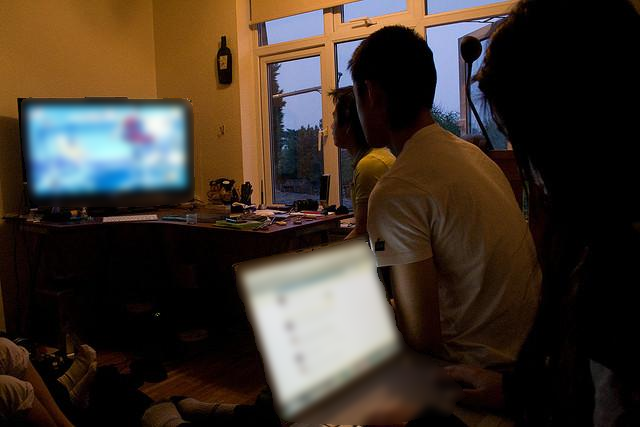

In [ ]:
image_path = "final_dataset/images/000000028824.jpg"

BlurSafe(image_path)

It works perfectly!

# Conclusion

After exploring multiple ways to perform segmentation, we decided to fine tune a Mask R-CNN and use it as a final model. We had an extremely enriching experience with this project, and we are happy with the final output.